## Processing Ocean Color Imagery

This is flight 20210827_A1 from gulf_stream_surveys.

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import geopandas as gpd
import pandas as pd


import os, glob
import multiprocessing
import math

#import cv2
import numpy as np
import matplotlib.pyplot as plt

#import exiftool
import datetime
from datetime import timedelta


import rasterio

from utils import *
from georeg import *

Define the data directory

In [3]:
data_dir = os.path.join('data', '210827_A1_frontcross1')
data_dir

'data/210827_A1_frontcross1'

In [4]:
! ls data/210827_A1_frontcross1

0000SET  RedEdge			 SYNLog-13-39-33_27-08-2021_edit.csv
anims	 sea
panel	 SYNLog-13-39-33_27-08-2021.csv


Grab last 4 characters of the file names, which are the img numbers and sort them

In [5]:
def last_10chars(x):
    return(x[-10:])

img_fns = glob.glob(data_dir + '/sea' + "/*.tif")

img_fns = sorted(img_fns, key = last_10chars)
len(img_fns)

3048

Open up the logs from the aircraft which are much more accurate than the GPS and compas from the Altum

In [6]:
alta_logs = format_alta_logs(data_dir + '/SYNLog-13-39-33_27-08-2021_edit.csv')
alta_logs.head()

,Reading,IMU Time,Date,GPS Time,Unnamed: 4,Longitude,Latitude,GPS Height,GPS Course,GPS Pos N,...,Gyro Bias P,Gyro Bias Y,Accel Bias X,Accel Bias Y,Accel Bias Z,Extended Status,5V Alarm,Z Vibration,Checksum,id
dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 13:39:34.000000,46,1.766,20210827,13:39:34,NaN,-747154560,356808608,2.92,4.3,183.02,...,-37.2736,8.8494,0.148,0.135,0.237,0,0,0.07,23,0
2021-08-27 13:39:34.000001,47,1.806,20210827,13:39:34,NaN,-747154560,356808608,2.92,4.3,183.02,...,-37.2708,8.8476,0.149,0.136,0.237,0,0,0.07,118,1
2021-08-27 13:39:34.000002,48,1.846,20210827,13:39:34,NaN,-747154560,356808608,2.92,4.3,183.02,...,-37.2703,8.8488,0.150,0.137,0.237,0,0,0.07,37,2
2021-08-27 13:39:34.000003,49,1.886,20210827,13:39:34,NaN,-747154560,356808608,2.92,4.3,183.02,...,-37.2672,8.8489,0.151,0.137,0.237,0,0,0.07,131,3
2021-08-27 13:39:34.000004,50,1.926,20210827,13:39:34,NaN,-747154496,356808608,2.91,4.2,183.02,...,-37.2624,8.8453,0.153,0.138,0.236,0,0,0.07,190,4


Path to the processed sea images

In [7]:
surface_dir = os.path.join(data_dir, 'sea', 'stacks')

### grab all the image metadata and visualize flight

In [8]:
mds = load_img_fn_and_meta(surface_dir, start=0)
len(mds)

507

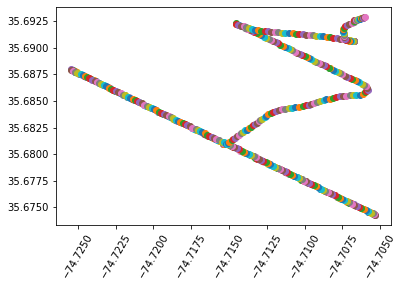

In [9]:
for md in mds:
    plt.scatter(md['Longitude'],md['Latitude'])
    plt.xticks(rotation=60)

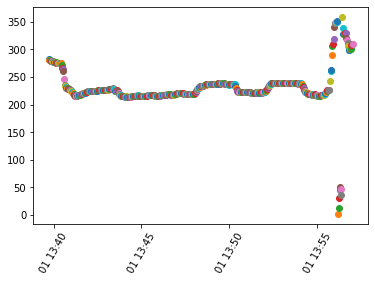

In [10]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['yaw'])
    plt.xticks(rotation=60)

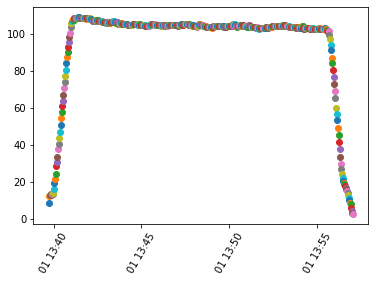

In [11]:
for md in mds:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

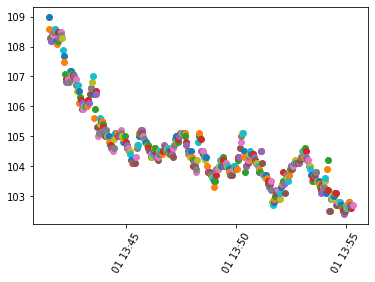

In [12]:
for md in mds[50:-50]:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['Altitude'])
    plt.xticks(rotation=60)

#### Open up a subset of the images to visualize based on the above metadata

All images can't be opened at the same time given the load on computer memory

In [13]:
start = 50 # where to start in the image order
count = 40 # how many images to open
sea_imgs, sea_img_metadata = retrieve_imgs_and_metadata(surface_dir, count=count, start=start, altitude_cutoff=0)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/rasterio/__init__.py:207: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


In [14]:
sea_imgs.shape

(40, 6, 1470, 2023)

Find the closest row in the flight logs based on time stamp and add the more accurate yaw to the metadata

In [15]:
for item in sea_img_metadata:
    utc_time = datetime.datetime.strptime('2021-08-27-' + item['UTC-Time'], '%Y-%m-%d-%H:%M:%S')
    img_idx = alta_logs.index.get_loc(utc_time, method='nearest')
    item['log_id'] = img_idx
    item['alta_yaw'] = (alta_logs.iloc[img_idx]['Yaw'] + 360) % 360
    # then ensures
    item['image_name'] = img_fns[start*6+item['id']*6]

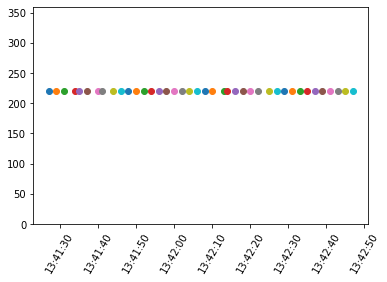

In [16]:
for md in sea_img_metadata:
    plt.scatter(datetime.datetime.strptime(md['UTC-Time'], '%H:%M:%S'), md['alta_yaw'])
    plt.xticks(rotation=60)
    plt.ylim(0,360)

In [17]:
sea_imgs.nbytes / 1e9

5.7097152

Open up the data from the sunblocked approach measurements

In [18]:
blocked_dir = os.path.join('data/210827_A1_frontcross1', 'RedEdge', 'tube', 'stacks')
blocked_dir

'data/210827_A1_frontcross1/RedEdge/tube/stacks'

In [19]:
blocked_imgs, blocked_img_metadata = retrieve_imgs_and_metadata(blocked_dir, count=20, start=0, altitude_cutoff=0)

Inspect a couple images, first with just blue and green

In [20]:
band_names = ['blue', 'green', 'red', 'nir', 'red edge']

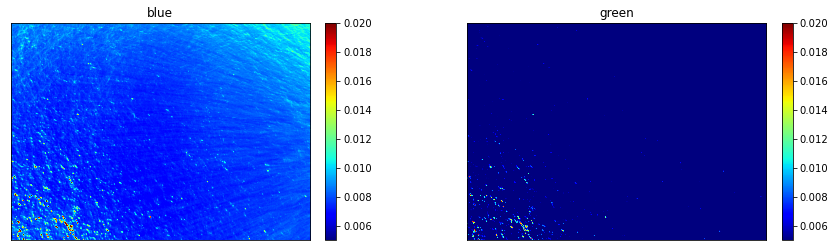

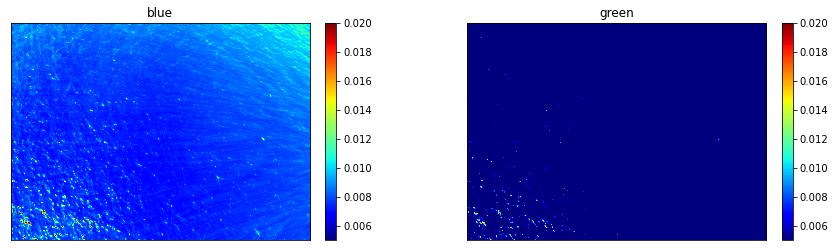

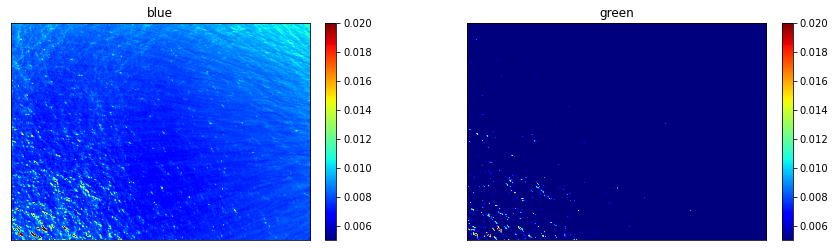

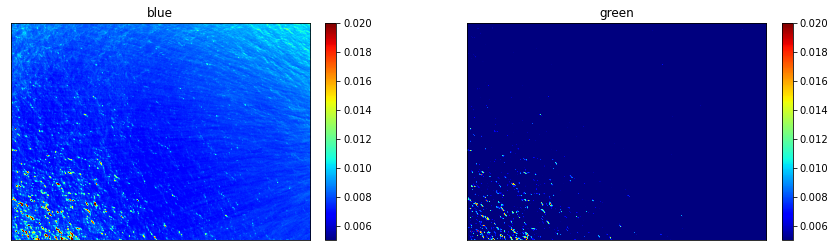

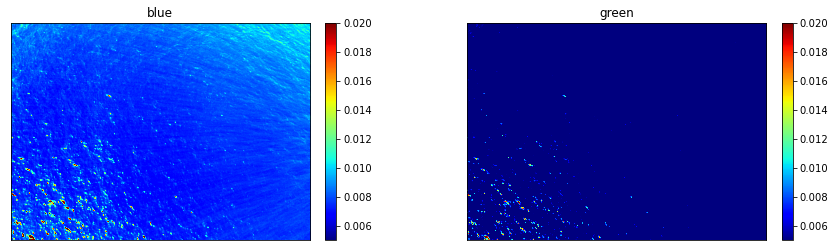

...

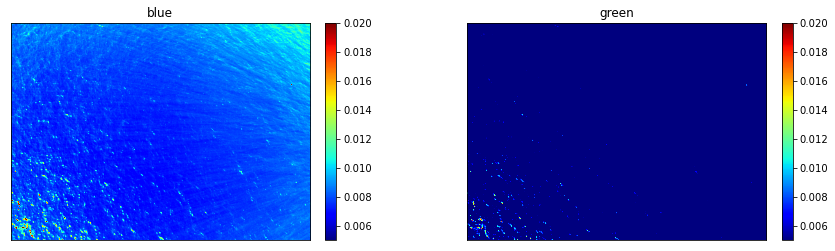

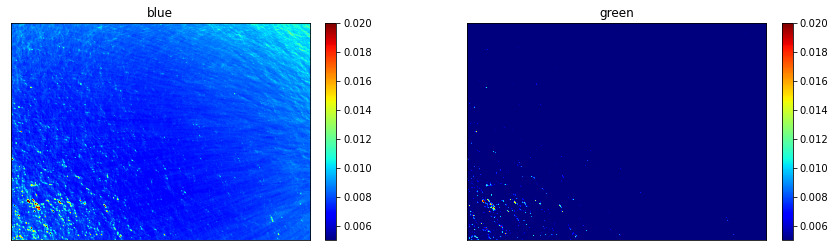

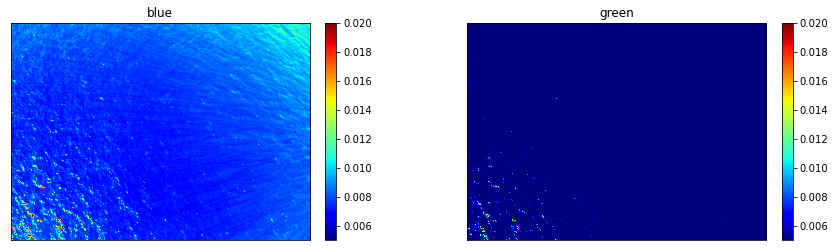

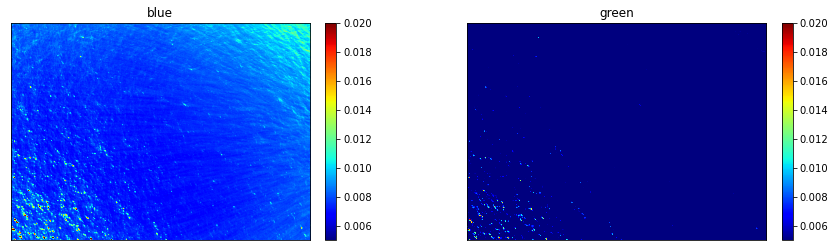

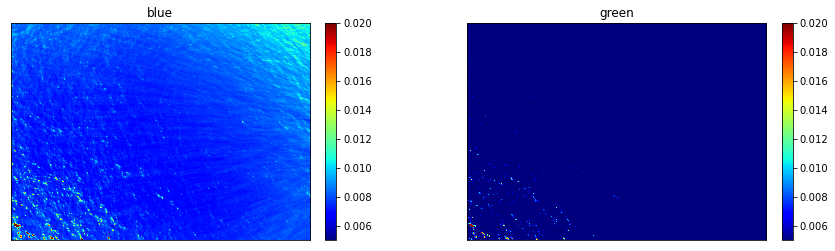

In [28]:
for i in range(15):
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(sea_imgs[i,1],cmap='jet', vmin=0.005, vmax=.02)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()

Now look at all bands

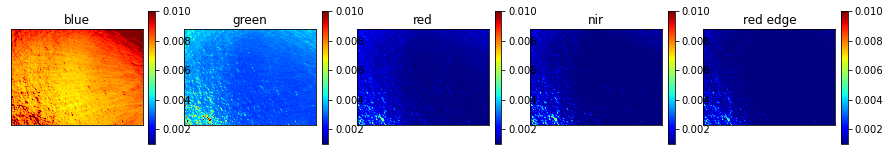

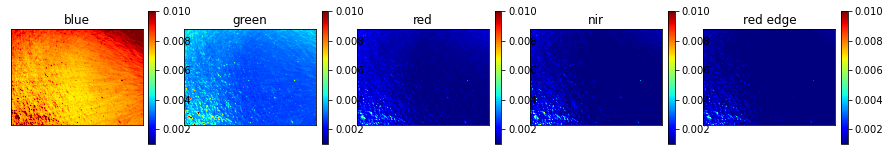

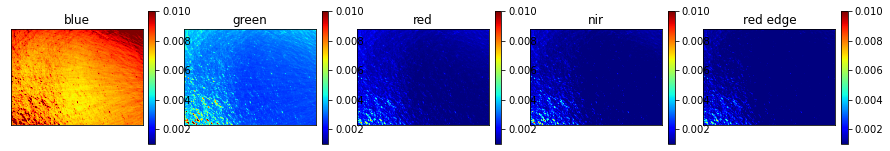

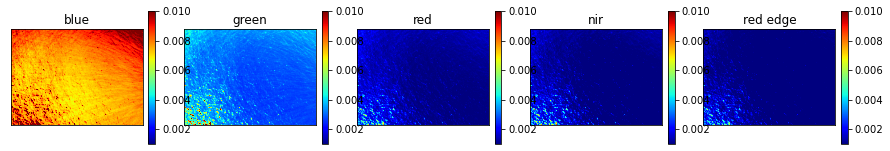

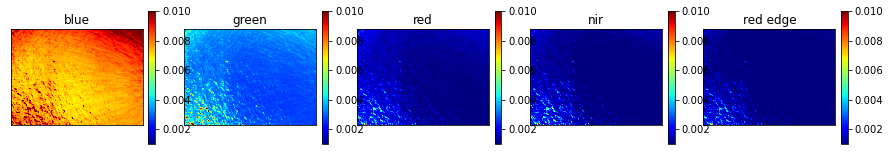

...

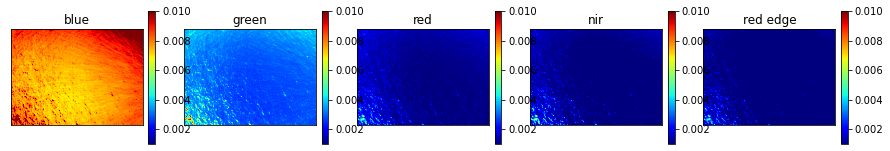

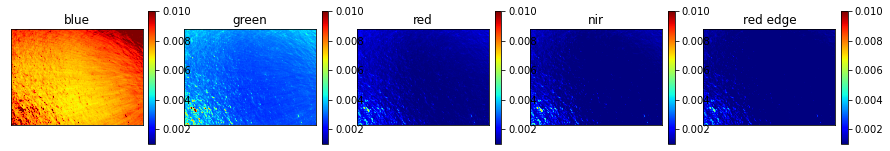

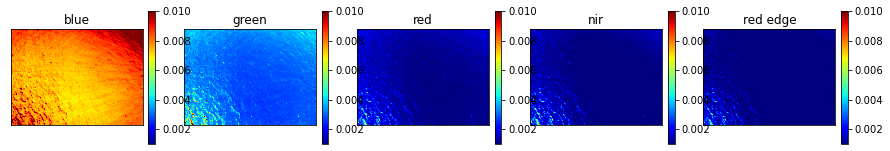

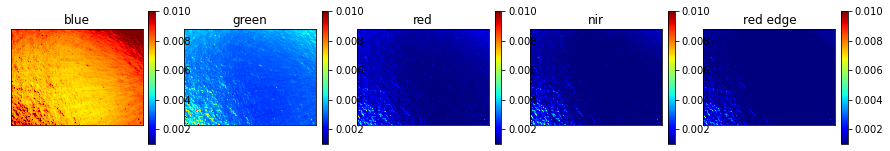

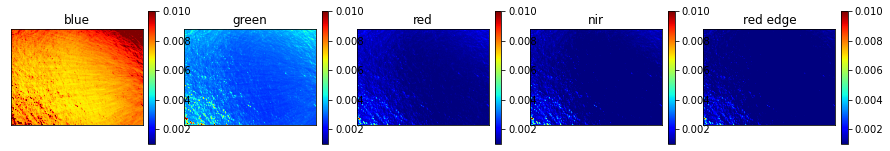

In [30]:
for j in range(15):
    fig, ax = plt.subplots(1,5, figsize=(15,4))
    for i in range(5):
        im = ax[i].imshow(sea_imgs[j,i],cmap='jet', vmin=0.001, vmax=.01)
        fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
        ax[i].set_xticks([])
        ax[i].set_yticks([])
        ax[i].set_title(band_names[i])

Visualize some stacked RGB images, the 0.01 value is just empirical to get a good idea of how the image looks when properly stretched

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


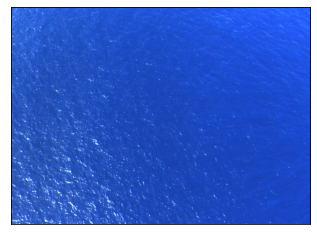

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


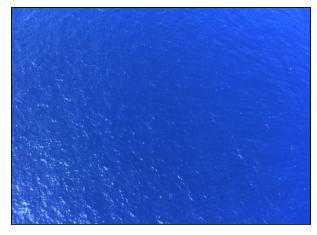

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


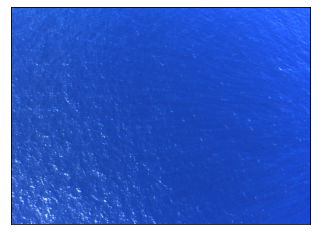

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


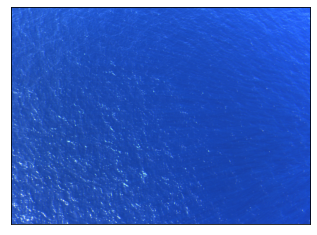

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


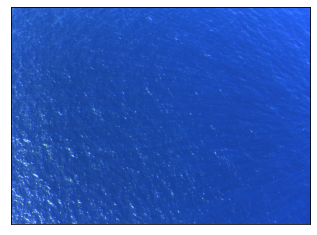

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


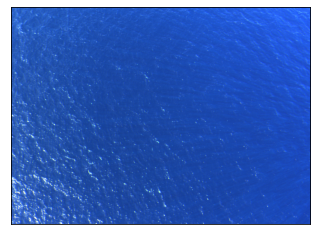

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


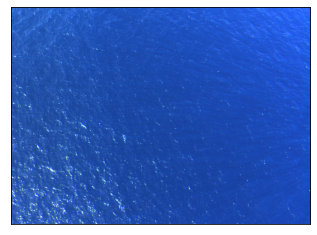

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


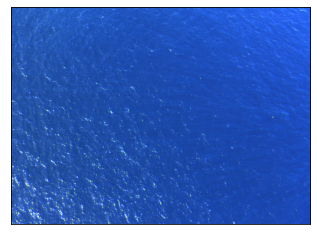

In [31]:
for j in [5,10,15,20, 25,30,35, 39,]:
    plt.imshow((np.transpose(sea_imgs[j,0:3]/0.01, (1,2,0))[:,:,::-1]))
    plt.xticks([])
    plt.yticks([])
    plt.show()

Save out every file as a png just for visualization

In [ ]:
for i in range(50,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    fig,ax = plt.subplots(1,2,figsize=(16,6))
    ax[0].imshow((np.transpose(img[0,0:3]/0.01, (1,2,0))[:,:,::-1]))
    ax[1].imshow(img[0,5]*math.pi*32768/100-273.15,cmap='inferno', vmax=30,vmin=25)
    fig.savefig('data/210827_A1_frontcross1/anims/img_sst_'+str(i).zfill(4)+'.png')   # save the figure to file
    plt.close()  


## Start correction to obtain accurate Ls*rho from Lw from Lt measurements 

### create medians of each image for correction

In [21]:
sea_imgs.shape

(40, 6, 1470, 2023)

Which images are used to median the data has a major impact on the outcome and must be images without major outlier features or patterns

In [22]:
sea_median = np.median(sea_imgs[5:35], axis=0)

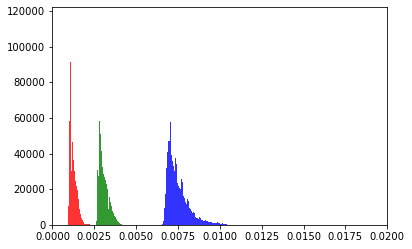

In [39]:
plt.hist(sea_median[0].flatten(), bins=300, color='blue', alpha=0.8)
plt.hist(sea_median[1].flatten(), bins=300, color='green', alpha=0.8)
plt.hist(sea_median[2].flatten(), bins=300, color='red', alpha=0.8)
plt.xlim(0.000,0.02)
plt.show()

In [40]:
np.median(sea_median, axis=(1,2))

array([0.00730011, 0.00296278, 0.00114626, 0.00095198, 0.00078198,
       0.2927668 ])

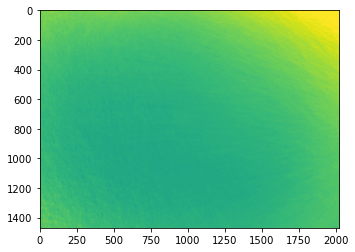

In [49]:
plt.imshow(sea_median[0], vmin=0.002,vmax=.01, cmap='viridis')

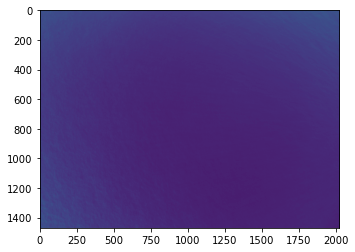

In [50]:
plt.imshow(sea_median[1], vmin=0.002,vmax=.01, cmap='viridis')

#### inspect the sun blocked spectra based on the brightest pixels there

The assumption is that the brightest pixels will be the ones that are measureing Lw rather than the tube since the imagers FOV is so large

In [25]:
blocked_imgs.shape

(10, 5, 947, 1272)

brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204
brightest pixels used: 1204


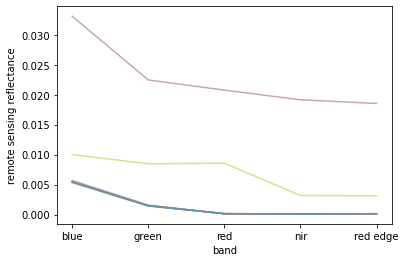

In [23]:
blocked_spectra = []
for i in range(0,blocked_imgs.shape[0]):
    spec = brightest_tube_pix(blocked_imgs[i], percent=0.001)
    plt.plot(band_names, spec, alpha=0.5)
    plt.ylabel('remote sensing reflectance')
    plt.xlabel('band')
    blocked_spectra.append(spec)
blocked_spectra = np.array(blocked_spectra)

We then take the median of these brightest spectra to get the value used. This relies on a dozen or so measurements to ensure that outliers like from foam don't bias the measurements.

In [24]:
median_blocked_spec = np.median(blocked_spectra,axis=0)
median_blocked_spec

array([0.00548349, 0.00149464, 0.00014819, 0.00011114, 0.00014137])

Define the ocean color index from Hu et al 2012

In [25]:
ci1 = -0.49
ci2 = 191.6590

# ci1 = -0.38152295986028695
# ci2 = 271.37634868

# average of 443*.5 + 489*1.5
# ci1 = -0.30002281538304754
# ci2 = 310.5772338

# ci1 = -0.21380600002416383
# ci2 = 572.01573044



def oc_index(blue, green, red):
    blue, green, red = blue/math.pi, green/math.pi, red/math.pi
    CI = green - ( blue + (555 - 477)/(667 - 477) * (red - blue) )
    
    #print(green)
    #print(( blue + (555 - 443)/(667 - 443) * (red - blue) ))
    
    #print(CI)

    ChlCI = 10**(ci1 + ci2*CI)
    return(ChlCI)

This is the L8 OC2 algorithm from NASA

In [29]:
vec_chla_img(median_blocked_spec[0],median_blocked_spec[1])

1.5560197628735295

In [30]:
print('chla is: ', oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]))

chla is:  0.2513474202368834


In [83]:
def combined_oc(ChlCI, oc2m):
    thresh = [0.15, 0.20]
    if ChlCI <= thresh[0]:
        chlor_a = ChlCI
    elif ChlCI > thresh[1]:
        chlor_a = oc2m
    else:
        chlor_a = oc2m * (ChlCI-thresh[0]) / (thresh[1]-thresh[0]) +\
            ChlCI * (thresh[1]-ChlCI) / (thresh[1]-thresh[0])
    return(chlor_a)


In [84]:
combined_oc(oc_index(median_blocked_spec[0],median_blocked_spec[1], median_blocked_spec[2]),
            vec_chla_img(median_blocked_spec[0],median_blocked_spec[1]))

1.5560197628735295

Run through each image, subtract the blocked spectra, then find the average spectra, then run chla algorithm on it, then add it to list

### Correct for sun glint

This is the current approach to calculating rho based on sunblocked spectra

Simple explaination is:

Take the blocked spectra and subtract that from Lt and then smooth that over and that is the correction to all the other images.

Sea median - blocked_spectra is equivalent to lsky * rho. So then to get Lw in the future from Lt measurements all you need to do is subtract lsky * rho from Lt.

Calculate the smoothed Lt - Lw

This needs to be heavily smoothed so that no random waves remain in the final rho*Lsky

In [26]:
smoothed_lt_lw = ndimage.gaussian_filter(((sea_median[:5,:,:].T - np.median(blocked_spectra, axis=0)).T), sigma=(0, 45,45), order=0)

Visualize the sea median bands that we calculated previously

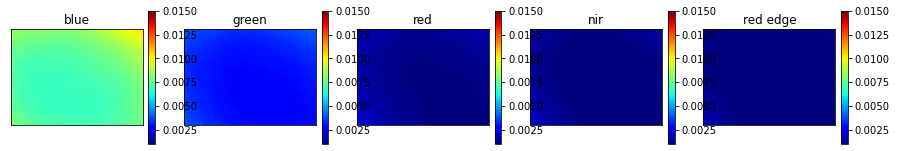

In [27]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i],cmap='jet', vmin=0.001, vmax=.015)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

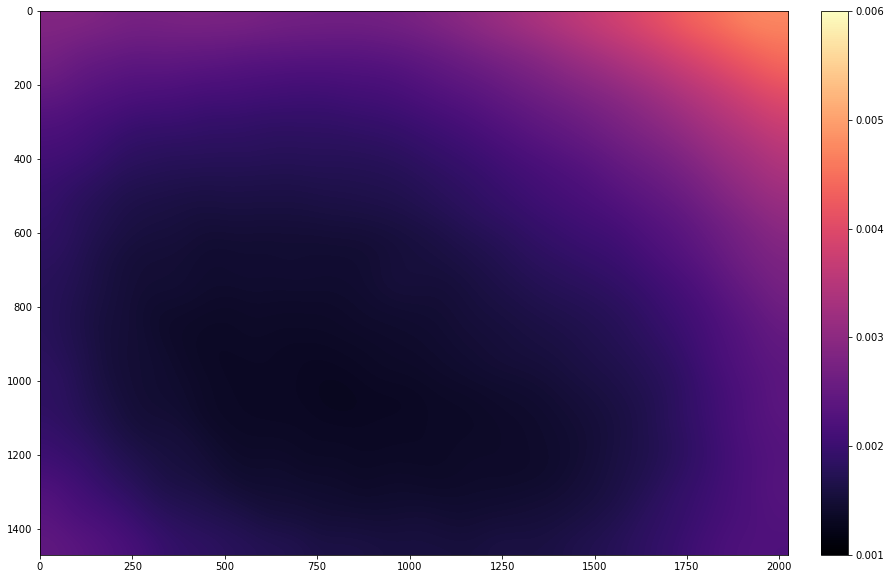

In [28]:
fig, ax = plt.subplots(figsize=(15,10))
im = ax.imshow(smoothed_lt_lw[0],cmap='magma', vmin=0.001, vmax=.006)
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Sea median images divided by image mean

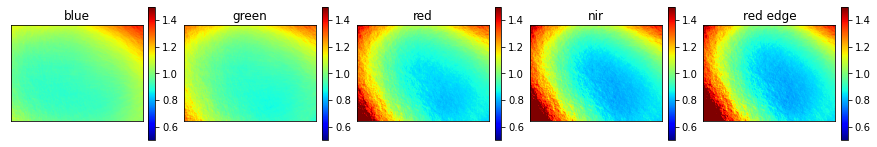

In [88]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(sea_median[i]/np.mean(sea_median[i]),cmap='jet', vmin=0.5, vmax=1.5)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

Histogram of data from these bands

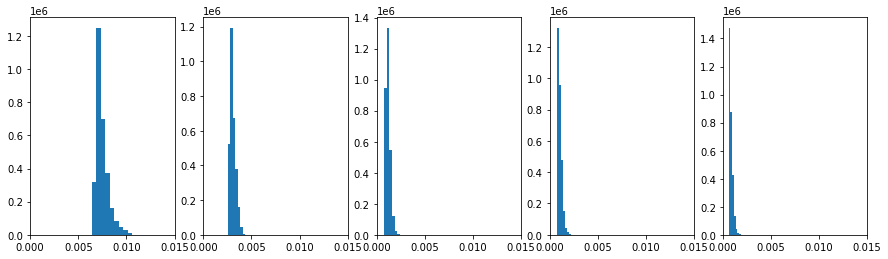

In [89]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    ax[i].hist(sea_median[i].flatten())
    ax[i].set_xlim(0,.015)

Smoothed lt - lw images (aka rho*lsky)

**This is what will be subtracted from each image**

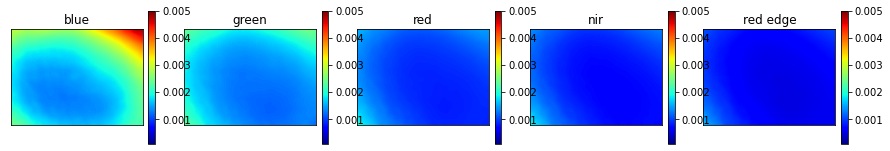

In [58]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i],cmap='jet', vmin=0.0001, vmax=.005)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

lt - lw divided buy the mean of that

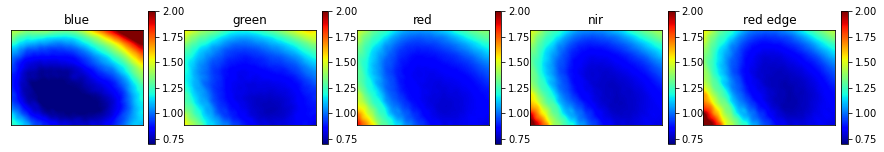

In [59]:
fig, ax = plt.subplots(1,5, figsize=(15,4))
for i in range(5):
    im = ax[i].imshow(smoothed_lt_lw[i]/np.mean(smoothed_lt_lw[i]),cmap='jet', vmin=.7, vmax=2)
    fig.colorbar(im, ax=ax[i], fraction=0.046, pad=0.04)
    ax[i].set_xticks([])
    ax[i].set_yticks([])
    ax[i].set_title(band_names[i])

### Apply simple approach

just take smoothed_lt_lw and subtract it from the lt images

First look at all bands

In [29]:
sea_imgs.shape

(40, 6, 1470, 2023)

In [30]:
np.median(blocked_spectra, axis=0)

array([0.00548349, 0.00149464, 0.00014819, 0.00011114, 0.00014137])

In [31]:
np.median(sea_imgs[5], axis=(1,2))

array([0.0076741 , 0.00301135, 0.00119483, 0.00099083, 0.00083541,
       0.29340307])

In [32]:
np.median(smoothed_lt_lw, axis=(1,2))

array([0.00181205, 0.00146978, 0.00099985, 0.0008434 , 0.00064121])

[0.00583681 0.00147552 0.00016475 0.00011772 0.00017712]


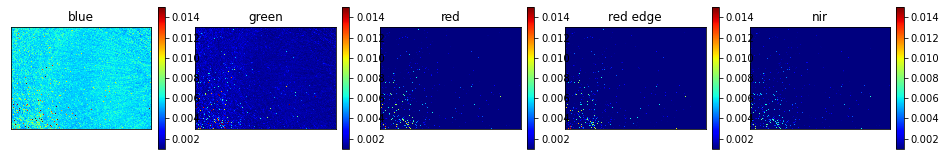

[0.0058161  0.00148619 0.00016646 0.00011926 0.00017487]


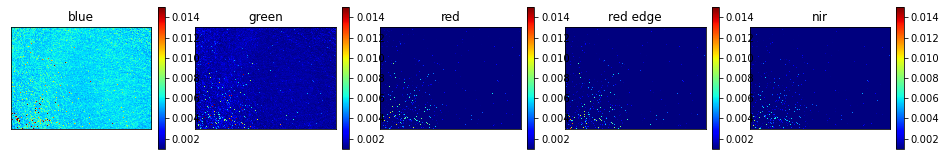

[0.00583272 0.00146564 0.00016654 0.00013286 0.00017505]


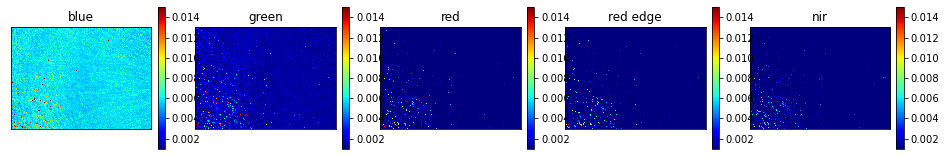

[0.00572643 0.00147576 0.00016713 0.0001462  0.00017437]


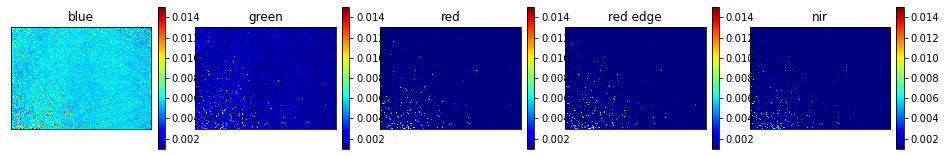

[0.00573585 0.00147627 0.0001652  0.00012774 0.0001729 ]


KeyboardInterrupt: 

In [33]:
for i in range(0,20):
    print(np.median(sea_imgs[i,:5] - smoothed_lt_lw, axis=(1,2)))
    visualize_darkest_pixels(sea_imgs[i,:5] - smoothed_lt_lw, lowest_percent=1, max_clim=0.015, min_clim=0.001, only_img=True)

Now let's look at before and after with blue and green bands using the same scale and filtering out some of the brightest pixels.

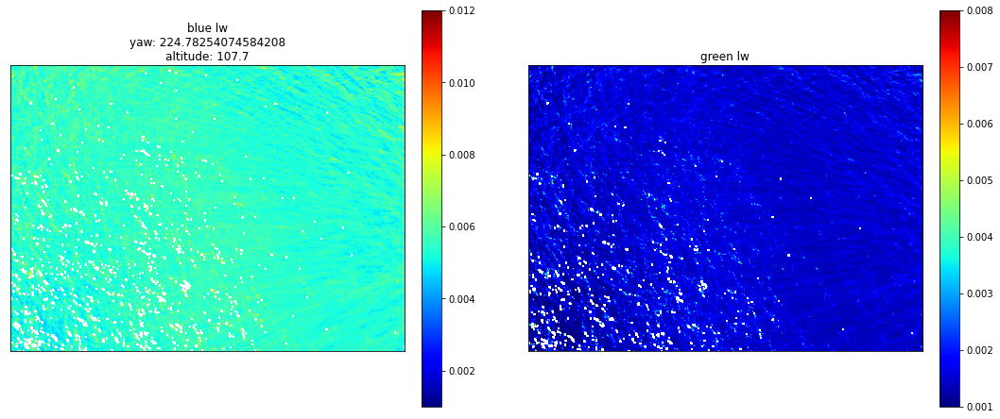

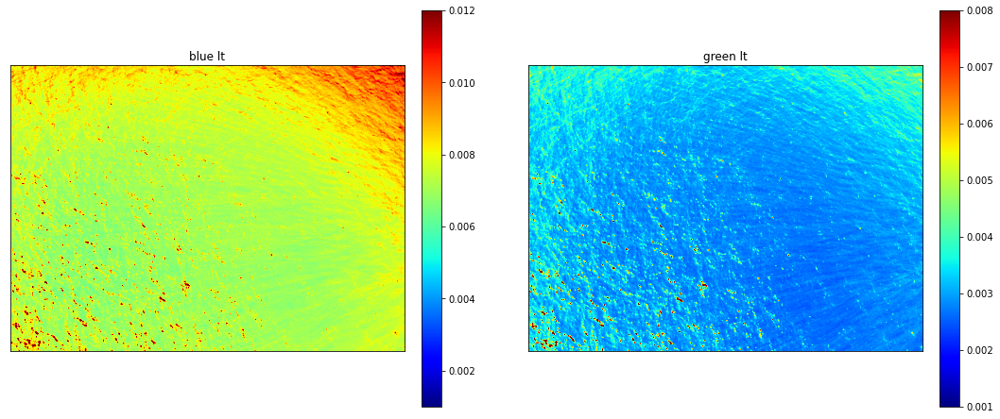

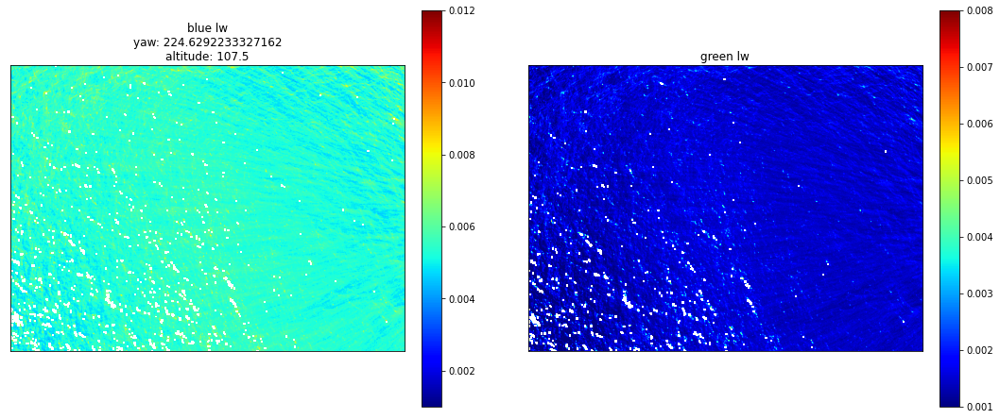

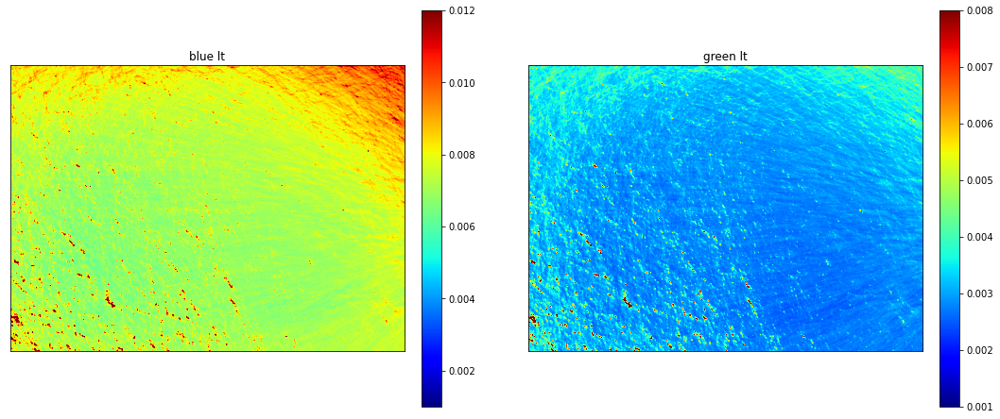

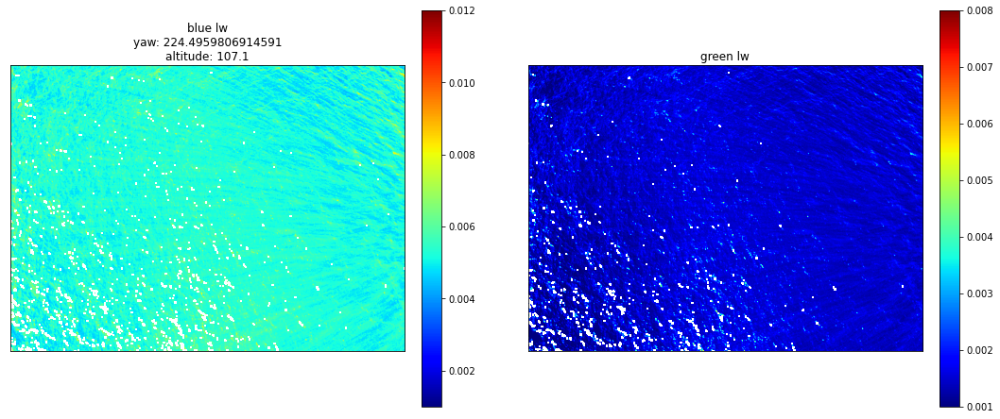

...

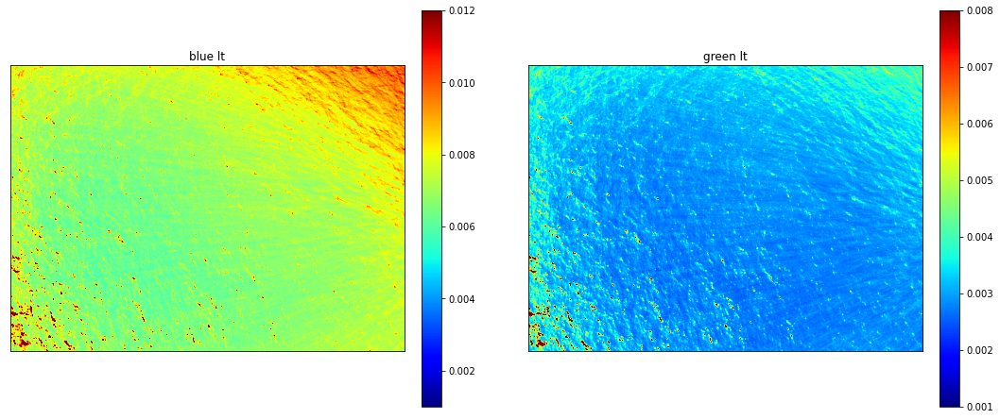

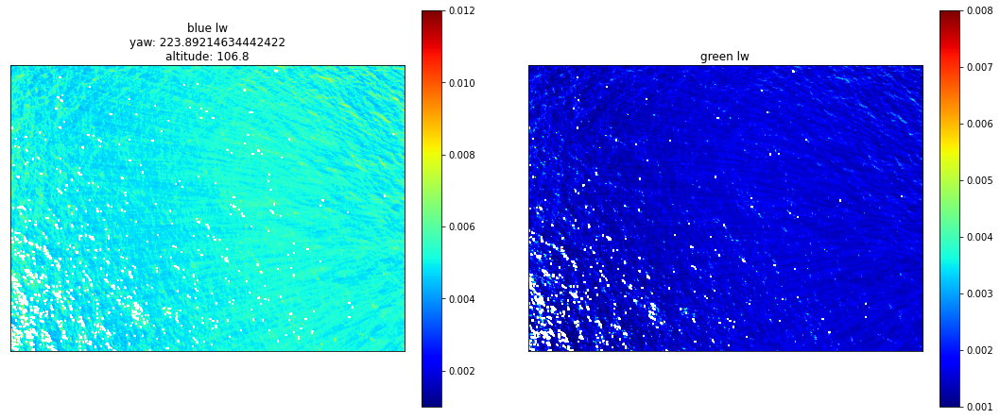

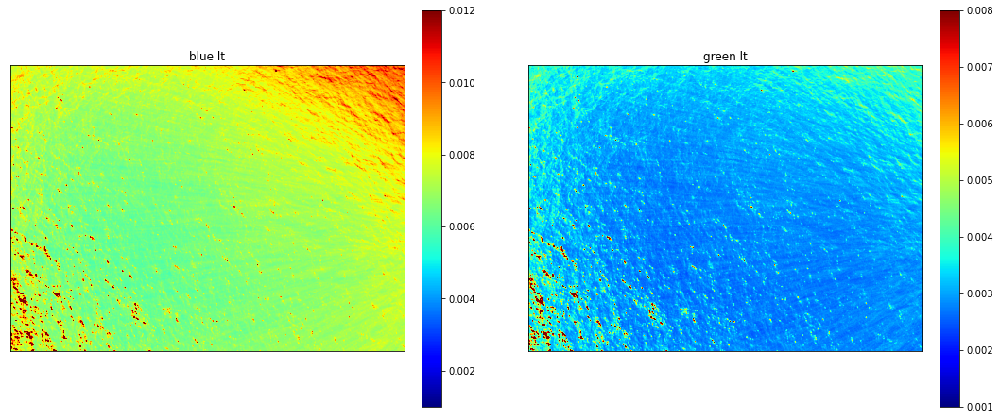

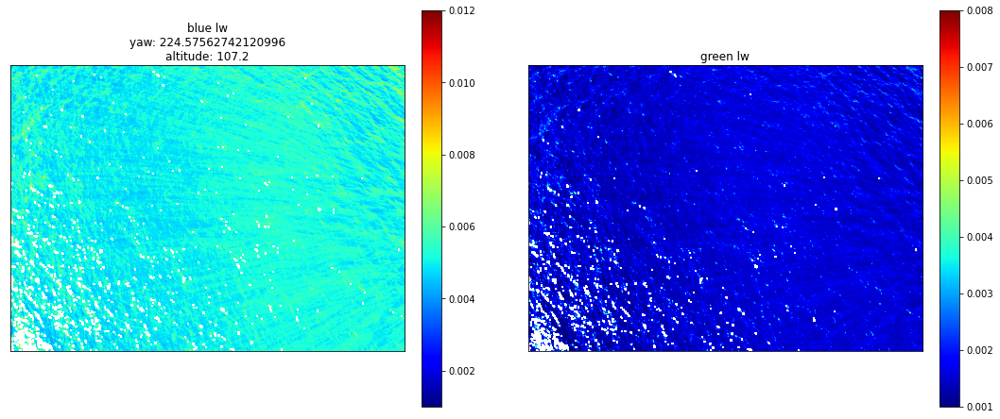

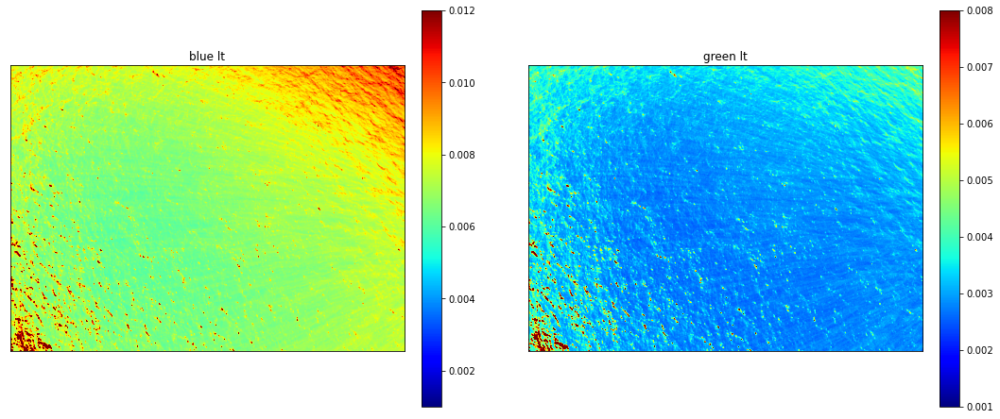

KeyboardInterrupt: 

In [34]:
for i in range(20,35):
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
    img[img > 0.012] = np.nan
    
    
    im = ax[0].imshow(img[0],cmap='jet', vmin=0.001, vmax=.012)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lw\nyaw: ' + str(sea_img_metadata[i]['yaw']) + '\naltitude: ' + str(sea_img_metadata[i]['Altitude']))
    im = ax[1].imshow(img[1],cmap='jet', vmin=0.001, vmax=.008)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lw')
    plt.show()
    
    fig, ax = plt.subplots(1,2, figsize=(18,8))
    
    im = ax[0].imshow(sea_imgs[i,0],cmap='jet', vmin=0.001, vmax=.012)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue lt')
    im = ax[1].imshow(sea_imgs[i, 1],cmap='jet', vmin=0.001, vmax=.008)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green lt')
    plt.show()

In general this seems to remove the sky reflection and the glare pixels 

#### Inspect the spectra from this

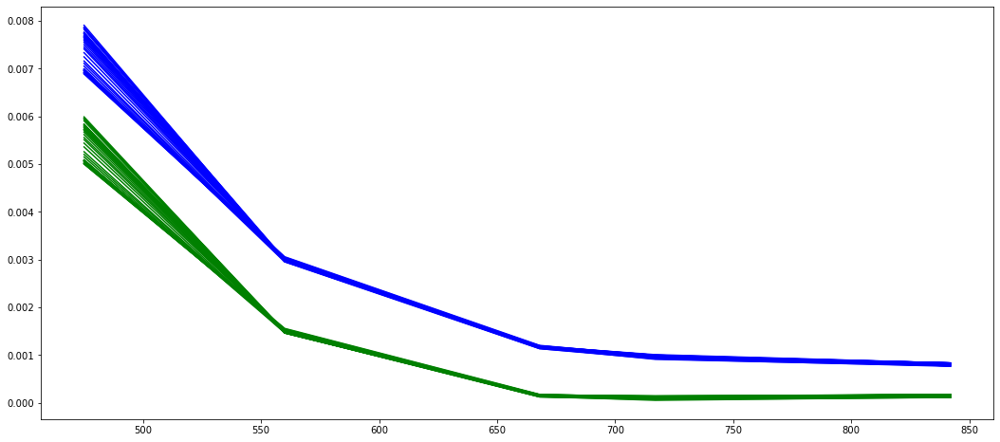

In [35]:
fig, ax = plt.subplots(figsize=(18,8))

for i in range(0,40):
    img = sea_imgs[i,:5] - smoothed_lt_lw
    
#    img[img > 0.055] = np.nan
    
    ax.plot([475, 560, 668, 717, 842],np.nanmedian(img,axis=(1,2)), color='green')
    ax.plot([475, 560, 668, 717, 842],np.nanmedian(sea_imgs[i,:5],axis=(1,2)), color='blue')

### Running analysis on all data

See the shift to more normal distributions after the corrections.

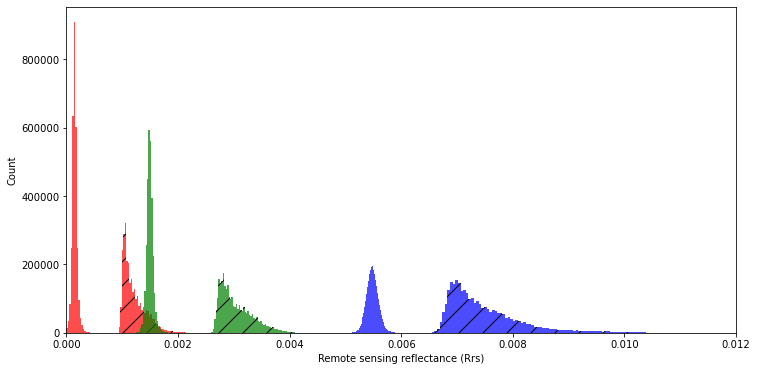

In [36]:
fig, ax = plt.subplots(figsize=(12,6))
ax.hist(sea_median[0,:,:].flatten(), bins=100, color='blue', hatch='/',alpha=0.7,)
ax.hist(sea_median[1,:,:].flatten(), bins=100, color='green', hatch='/',alpha=0.7)
ax.hist(sea_median[2,:,:].flatten(), bins=100, color='red',hatch='/',alpha=0.7)

ax.hist((sea_median[0,:,:]-smoothed_lt_lw[0]).flatten(), bins=100, color='blue', alpha=0.7)
ax.hist((sea_median[1,:,:]-smoothed_lt_lw[1]).flatten(), bins=100, color='green', alpha=0.7)
ax.hist((sea_median[2,:,:]-smoothed_lt_lw[2]).flatten(), bins=100, color='red', alpha=0.7)

ax.ticklabel_format(style='plain')
ax.set_ylabel('Count')
ax.set_xlabel('Remote sensing reflectance (Rrs)')

plt.xlim(0,0.012)
plt.savefig('oc_analysis_20210827_A1_gulf_stream_surveys_hist_lw_lt_sea_median.png')
plt.show()

#### Visualize chla output from current approach 

ocx median is:
0.2443021969282631


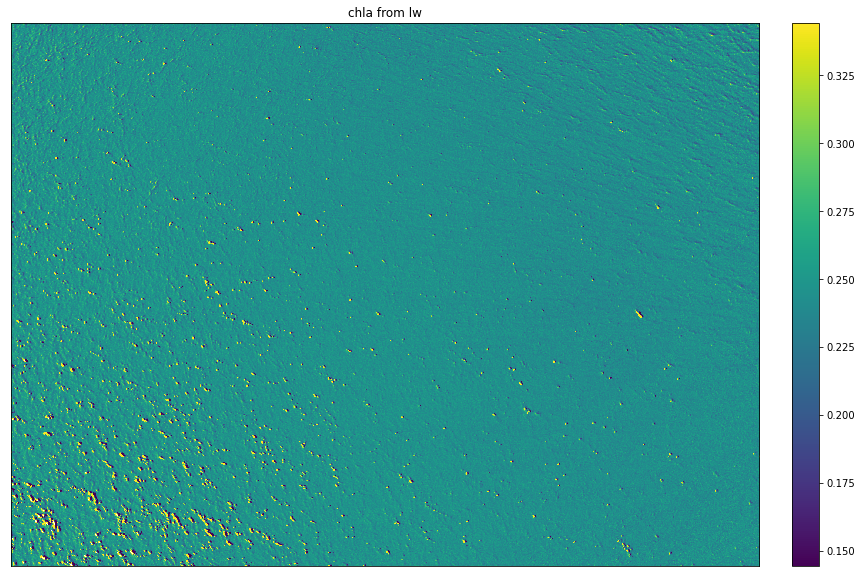

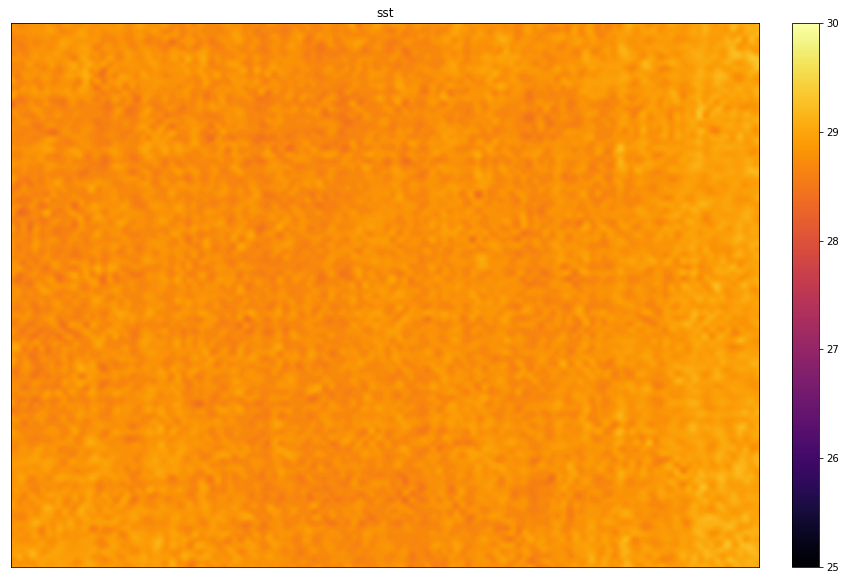

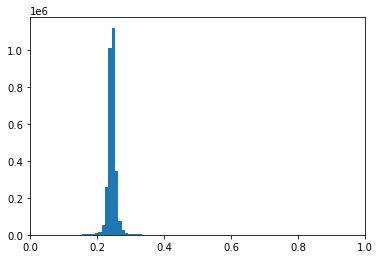

ocx median is:
0.24332871131564893


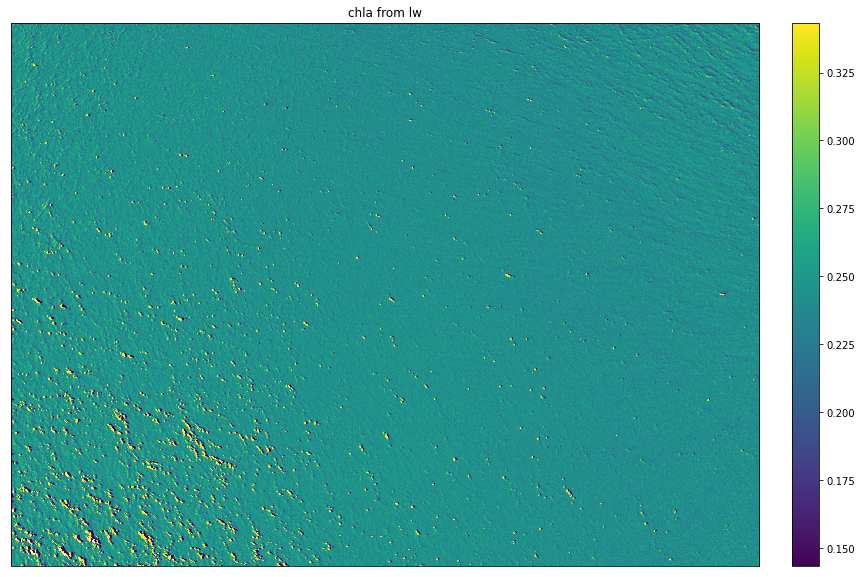

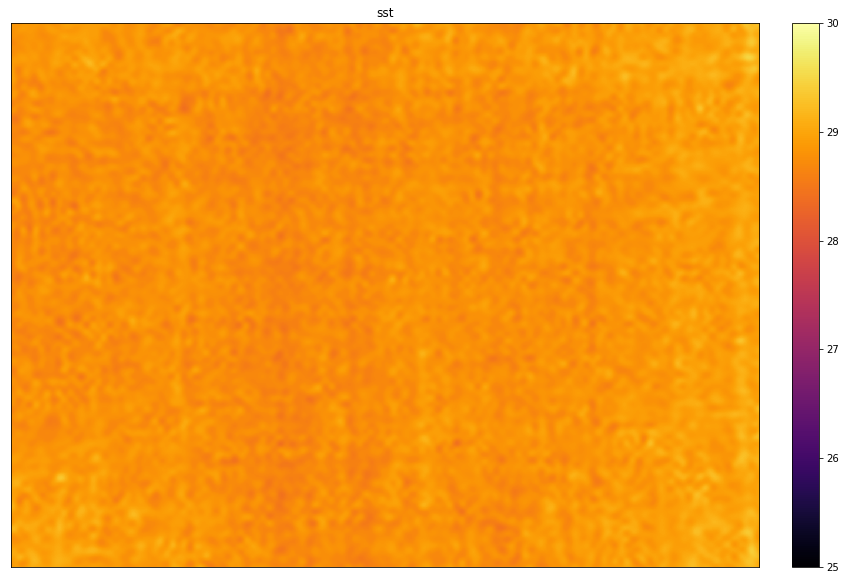

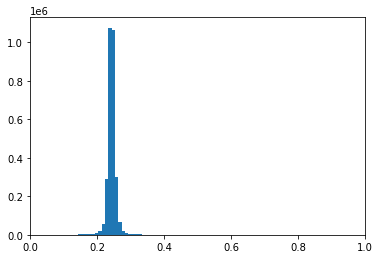

ocx median is:
0.24587490662102138


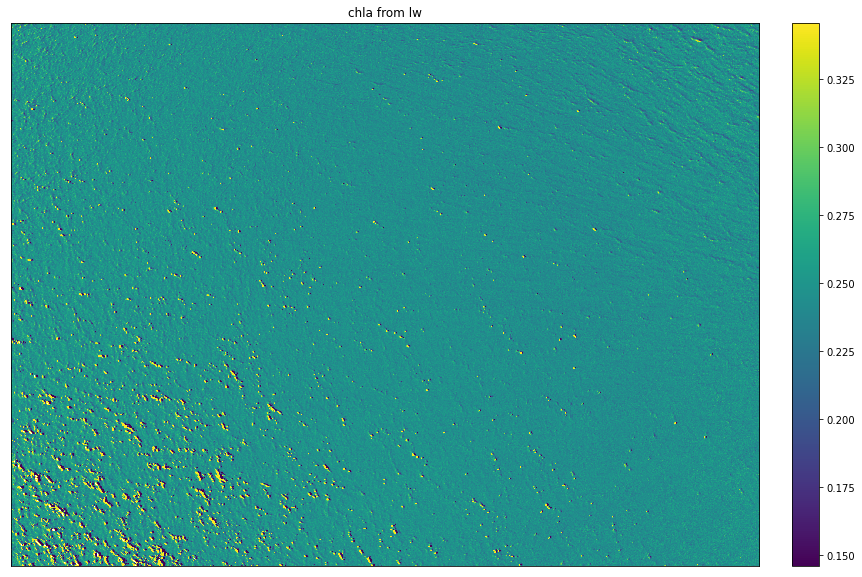

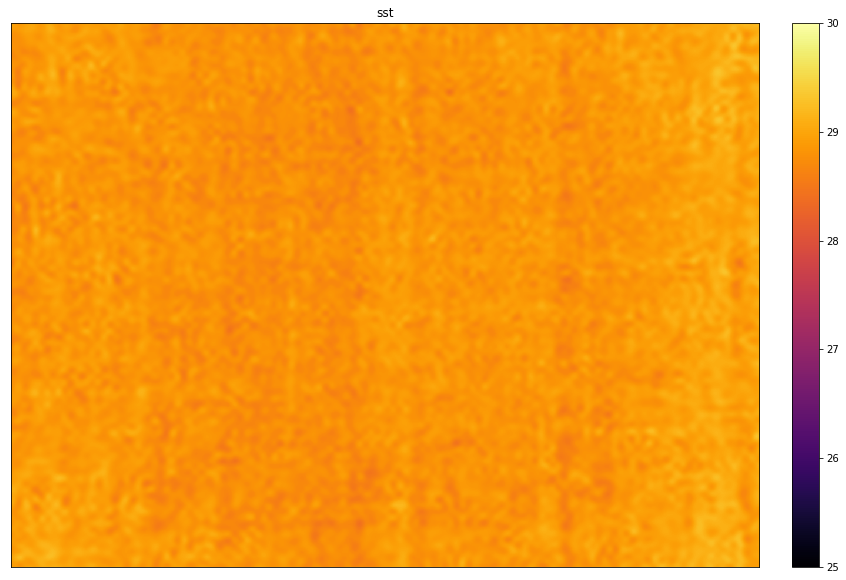

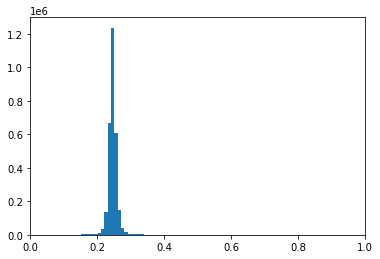

ocx median is:
0.24570651280005806


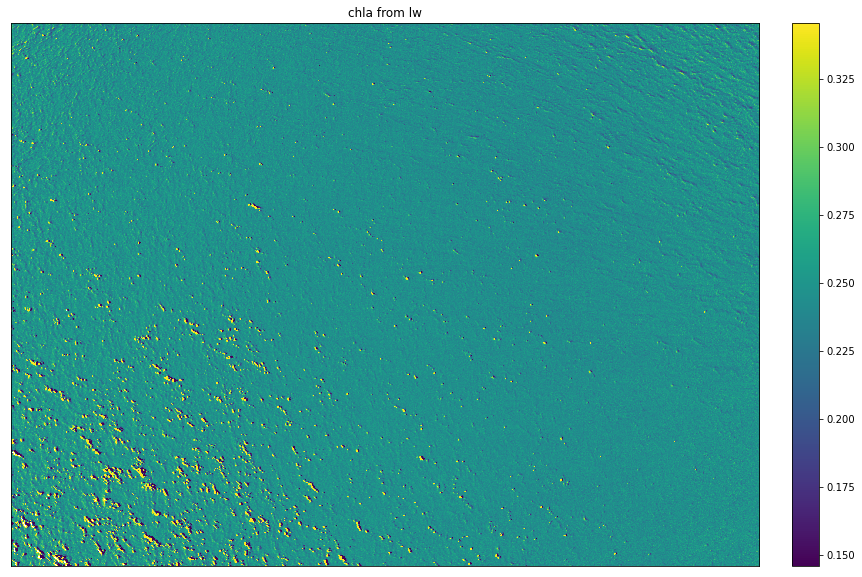

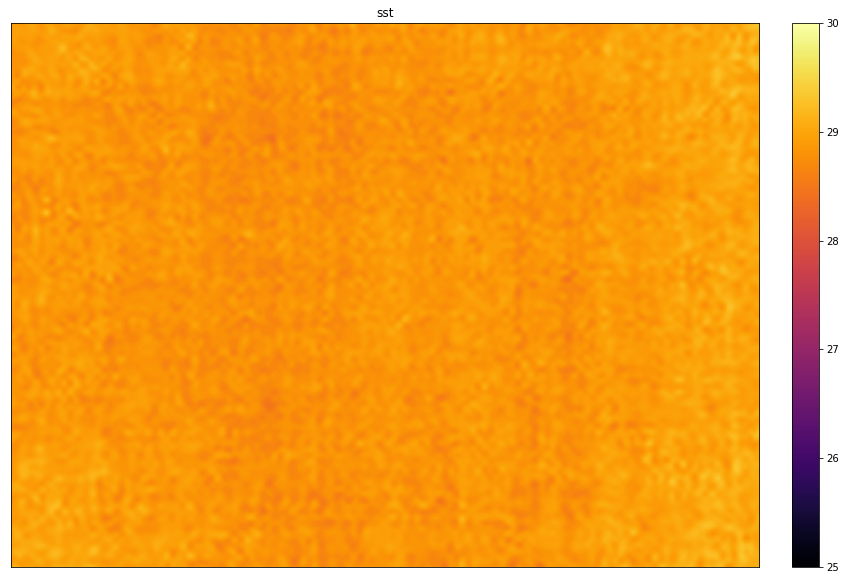

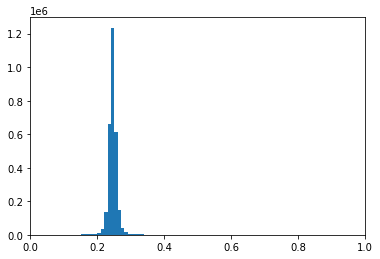

ocx median is:
0.24579741942167085


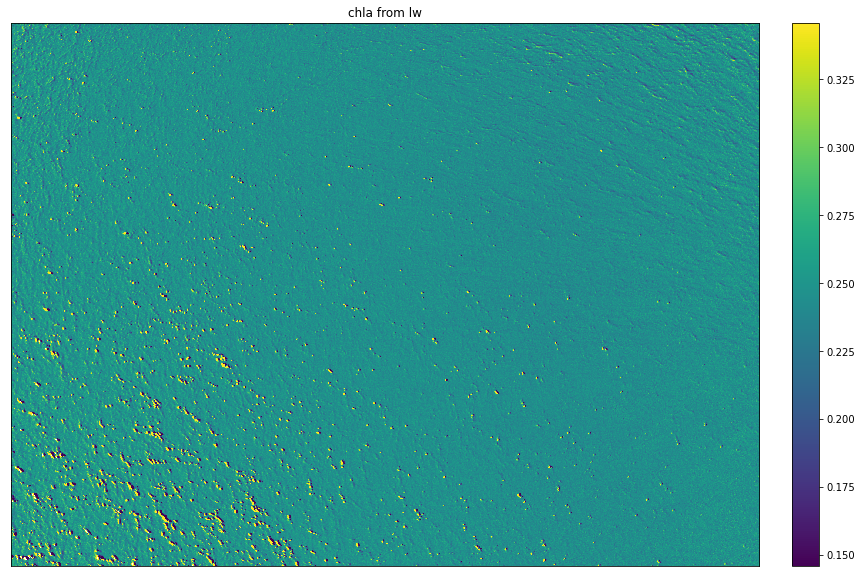

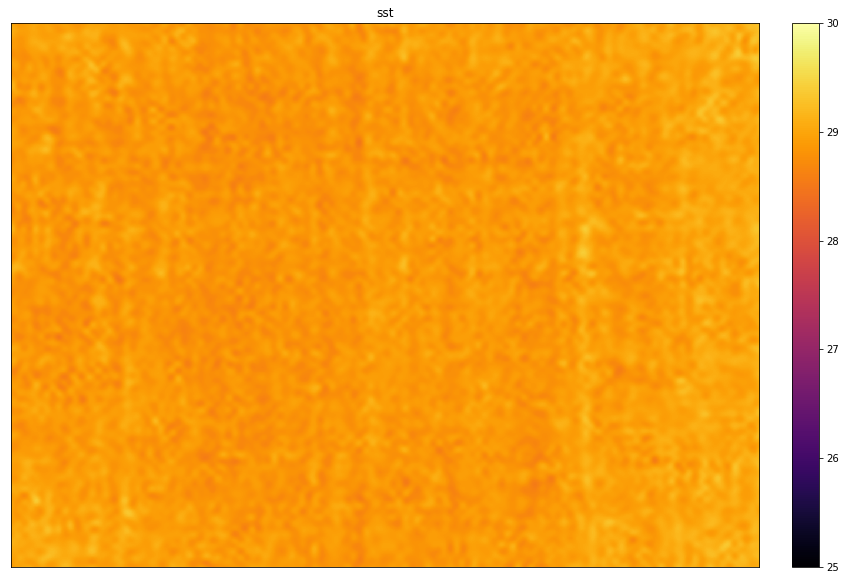

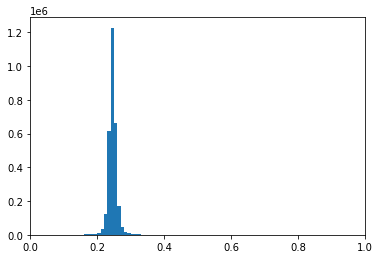

ocx median is:
0.24173047646177923


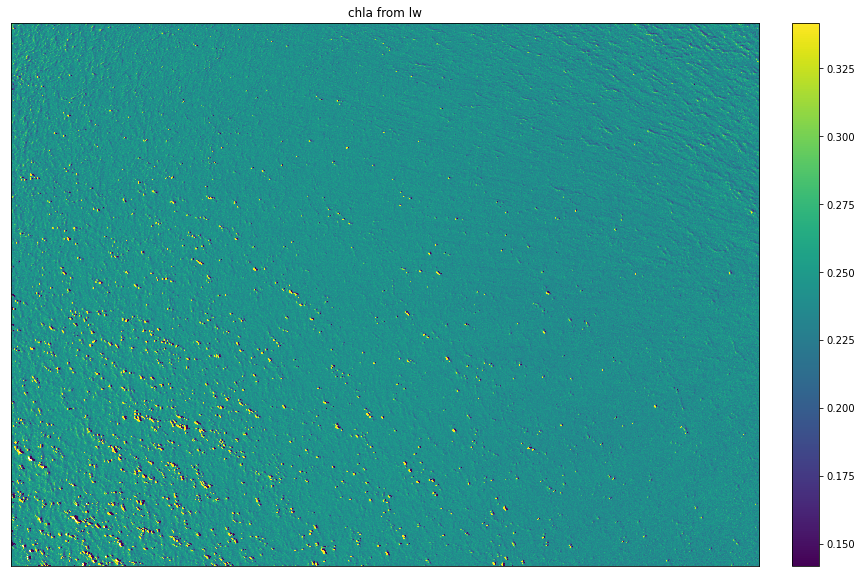

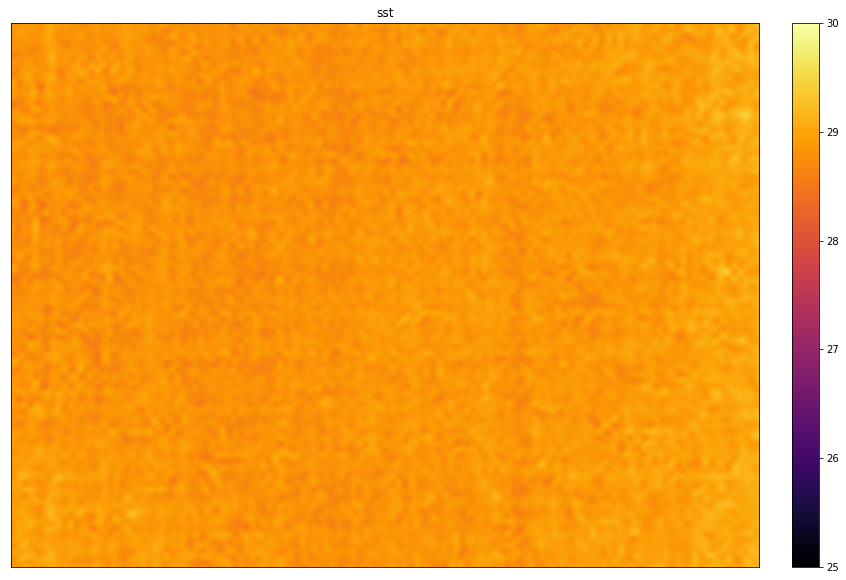

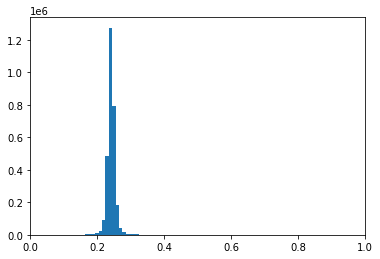

ocx median is:
0.24203364547203604


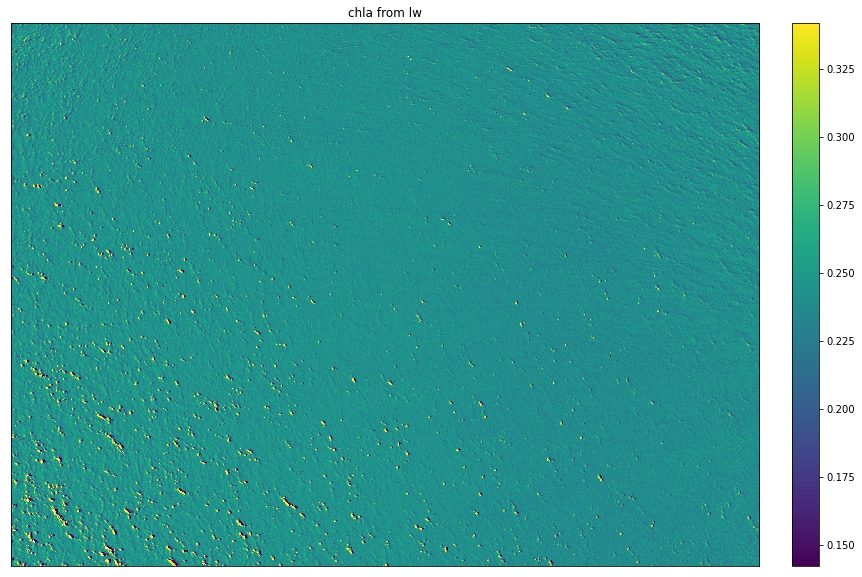

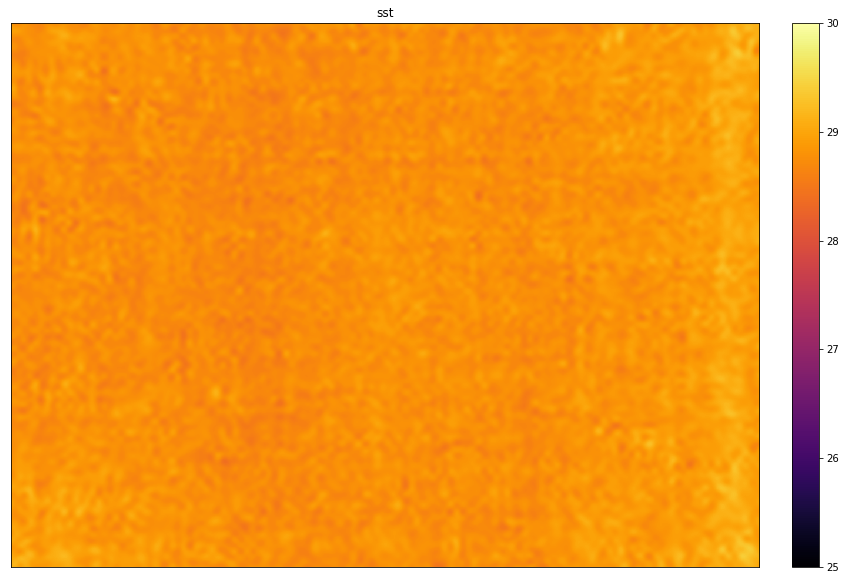

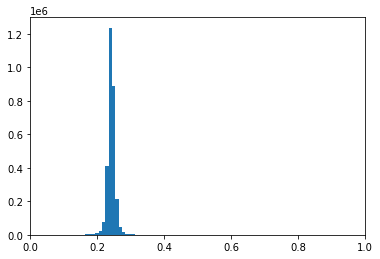

ocx median is:
0.24041695546438419


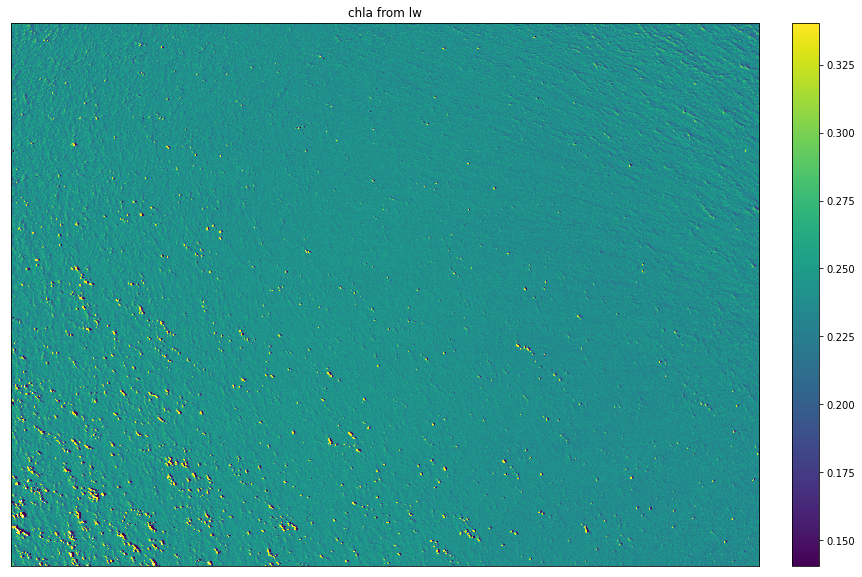

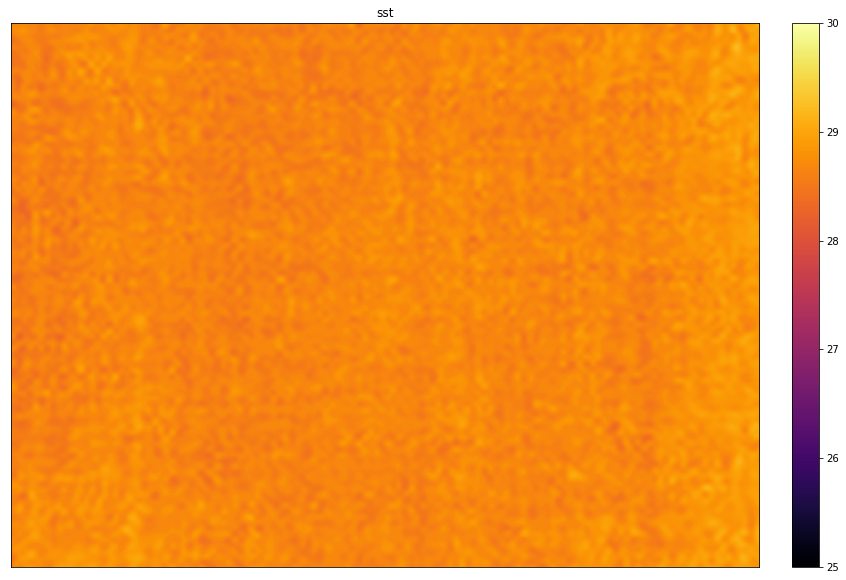

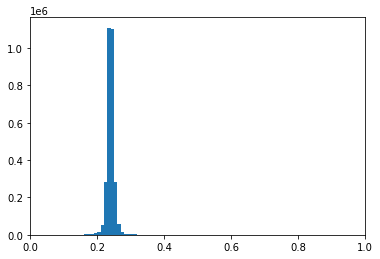

ocx median is:
0.24140065927506735


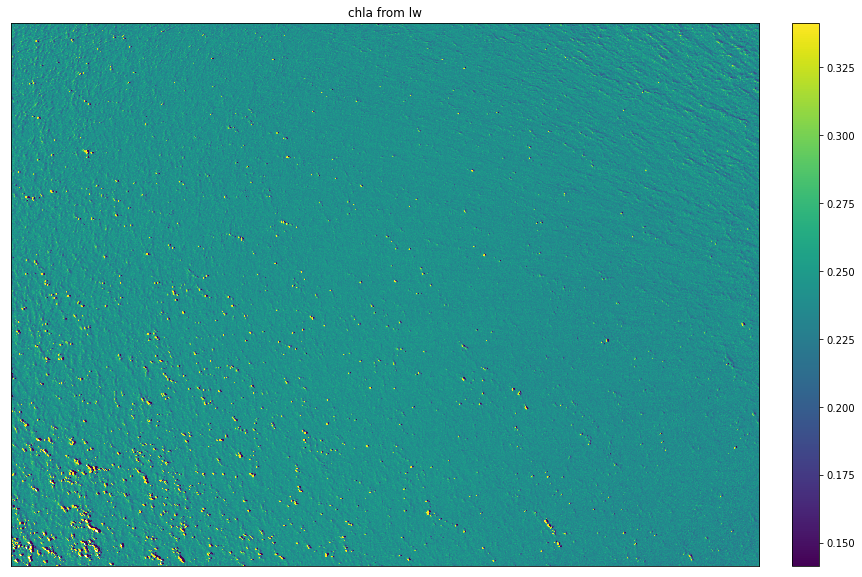

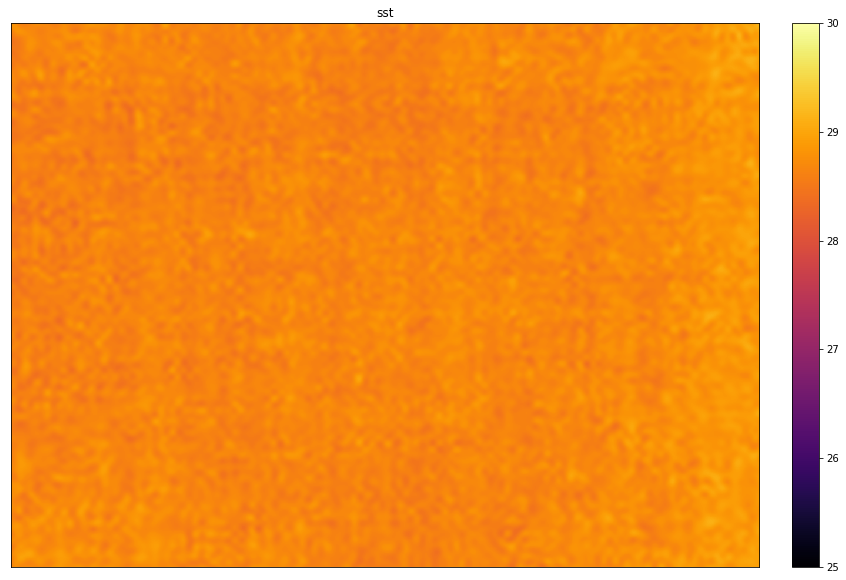

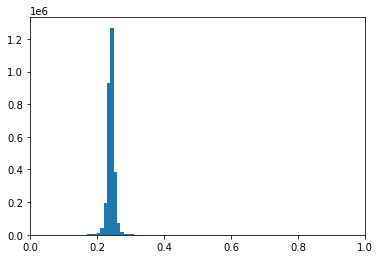

ocx median is:
0.2419585995914395


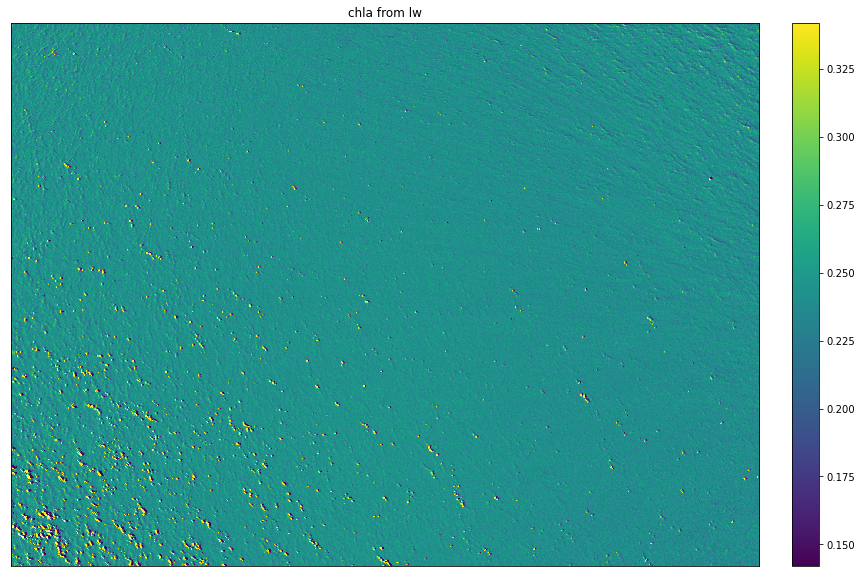

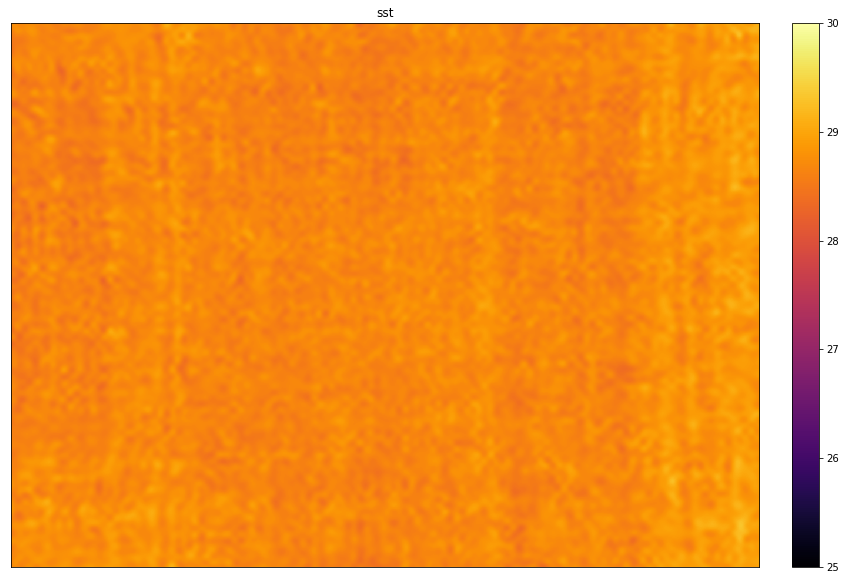

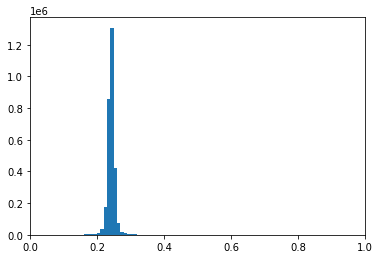

ocx median is:
0.2438336437670604


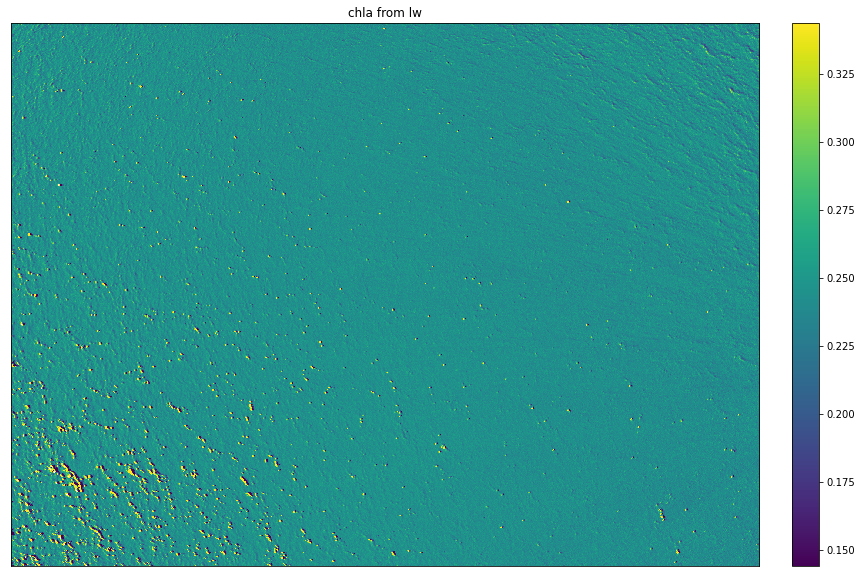

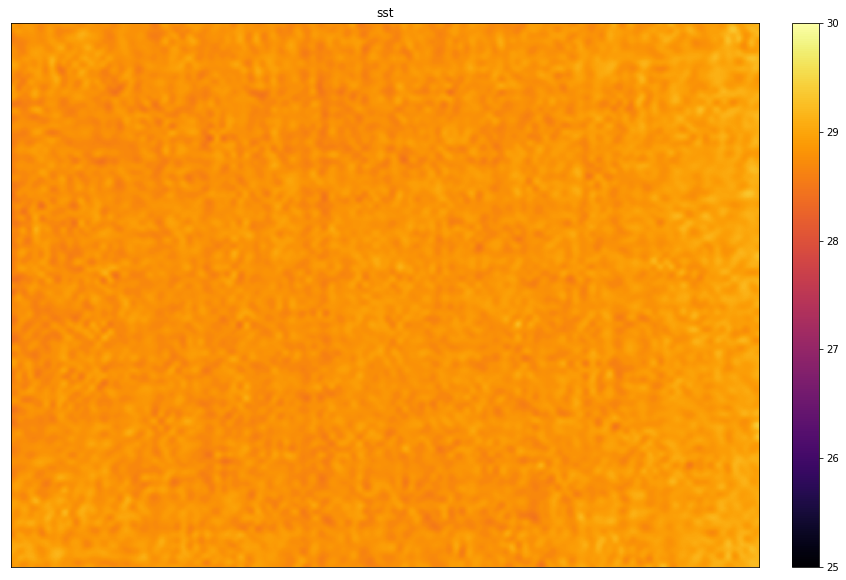

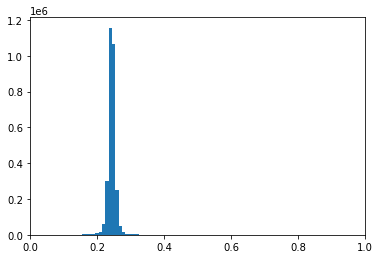

ocx median is:
0.2449777816315679


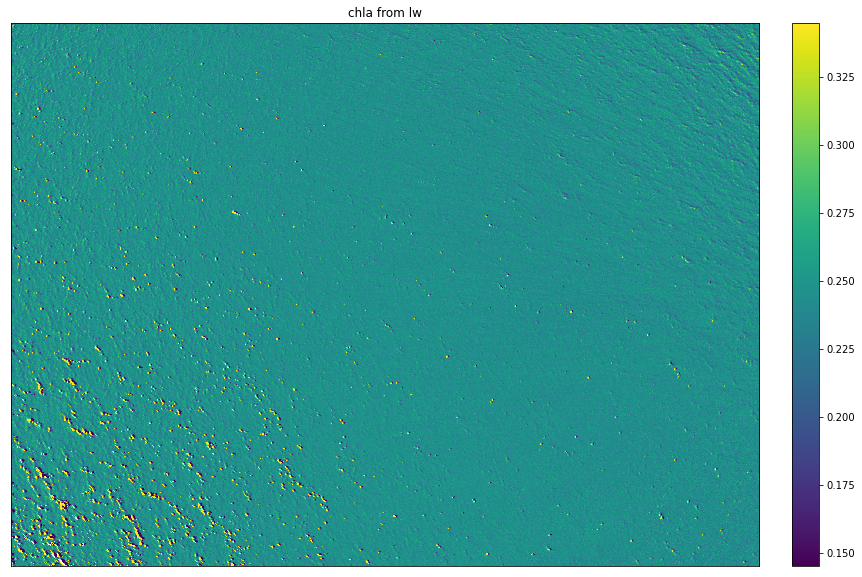

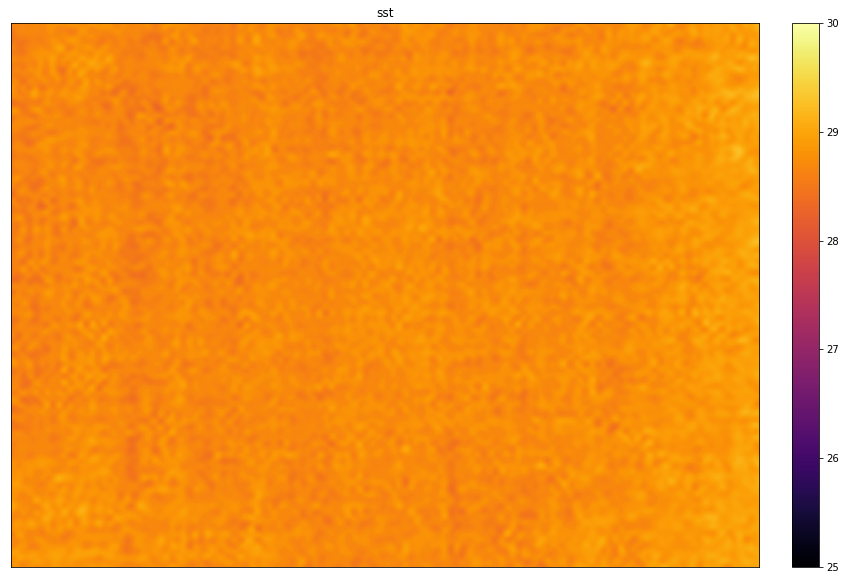

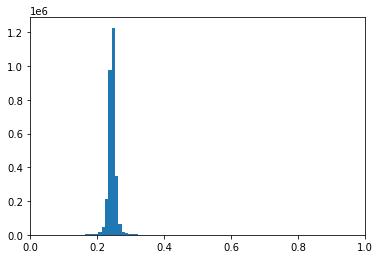

ocx median is:
0.24544974991216173


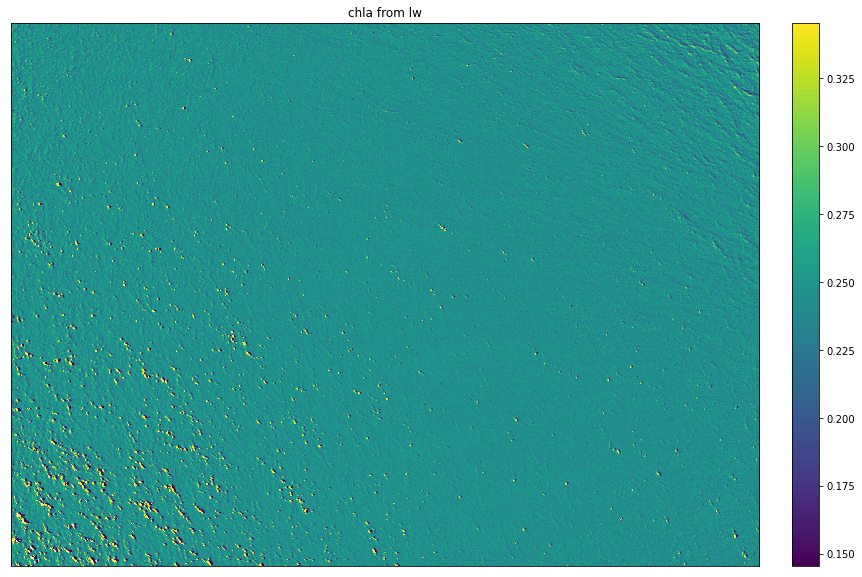

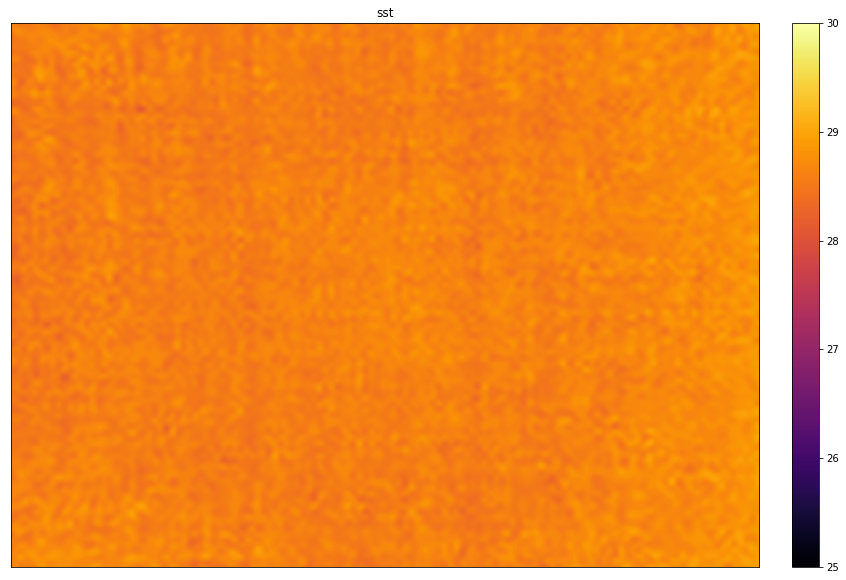

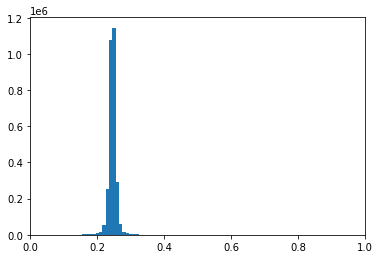

ocx median is:
0.2467941804592156


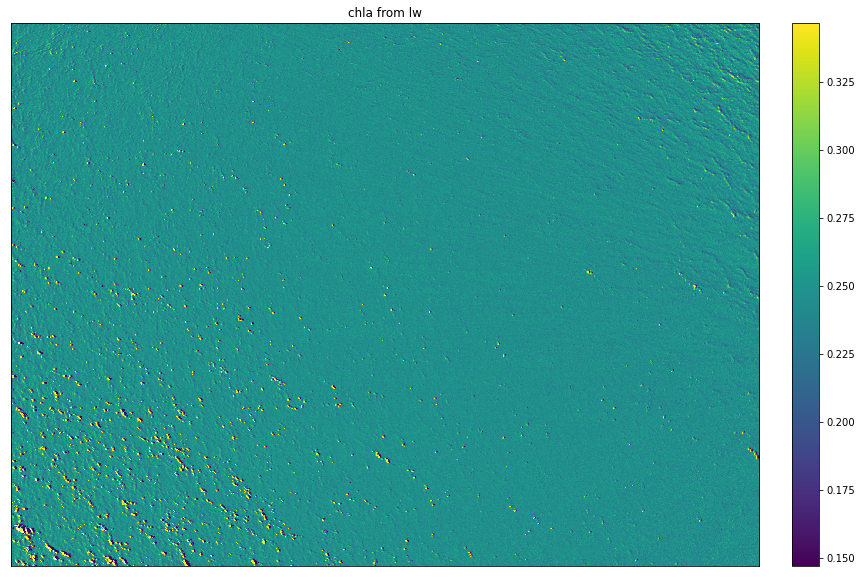

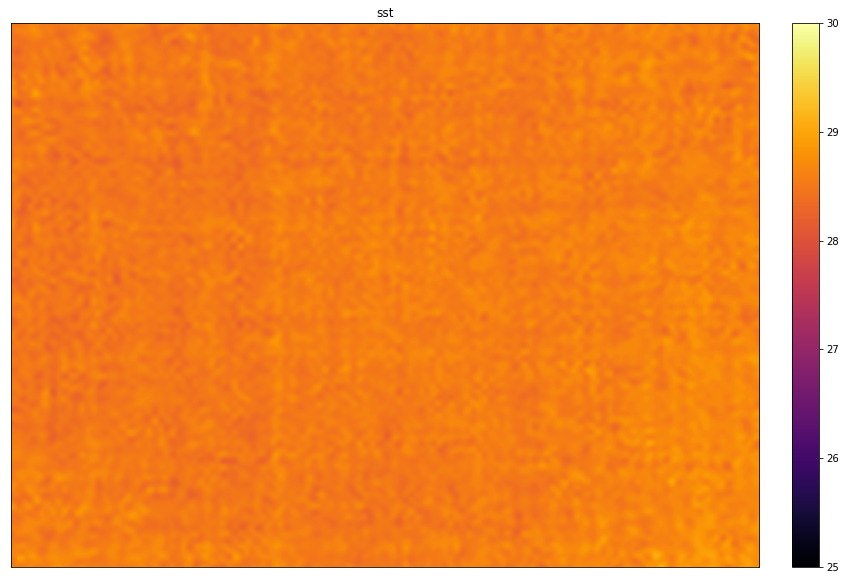

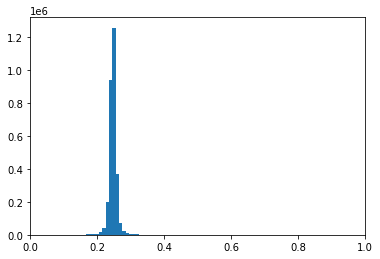

ocx median is:
0.24593861091771704


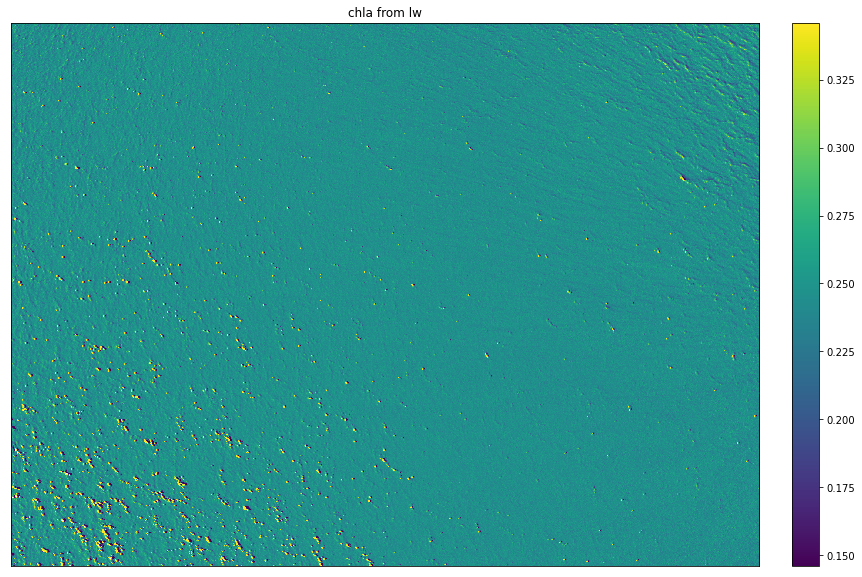

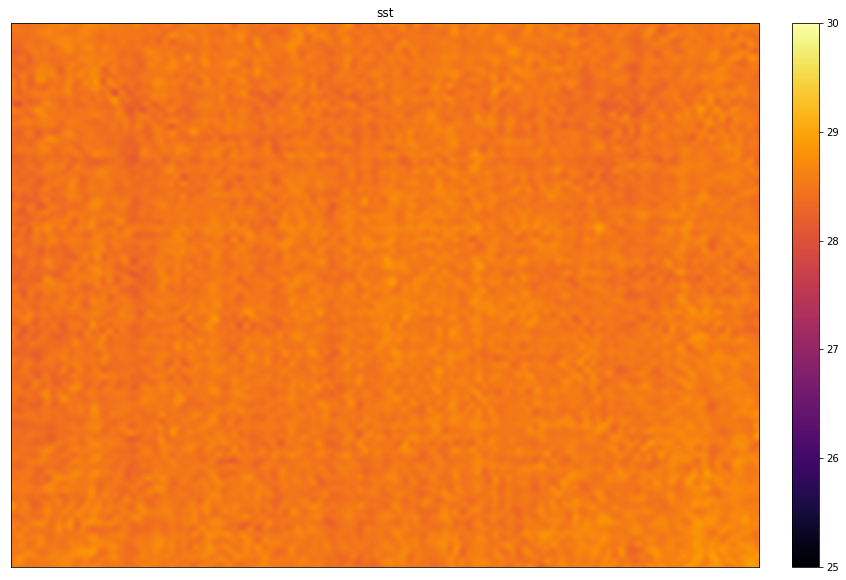

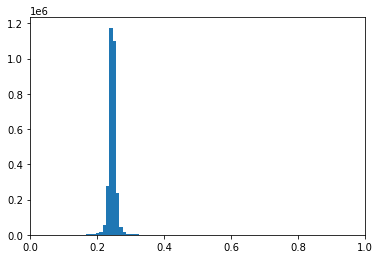

ocx median is:
0.24699655906578652


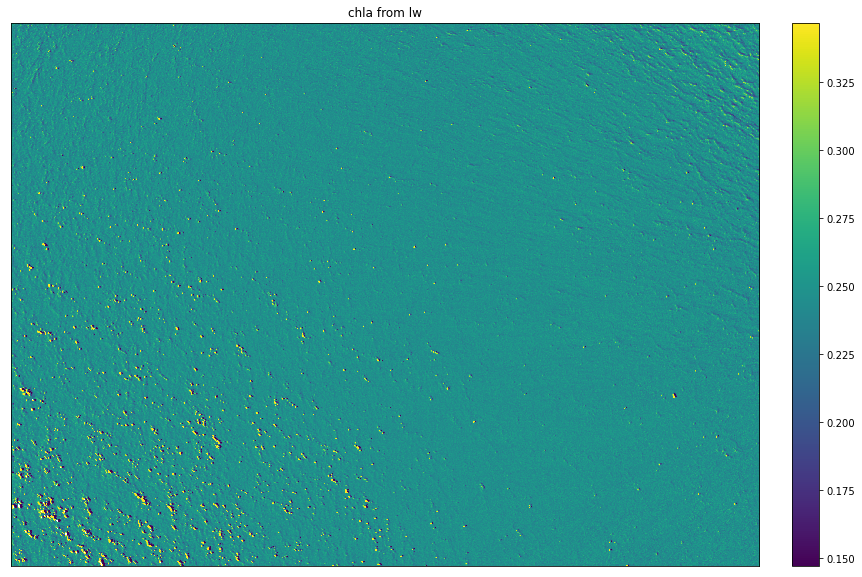

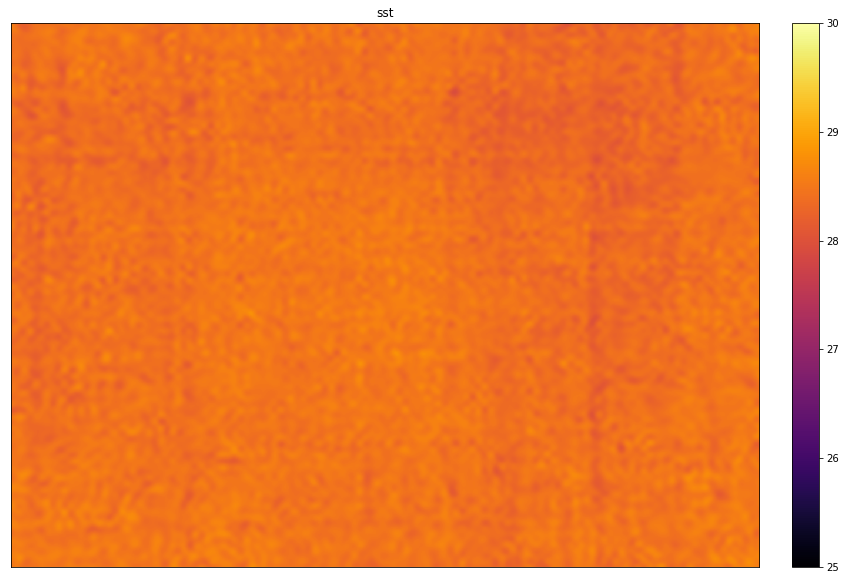

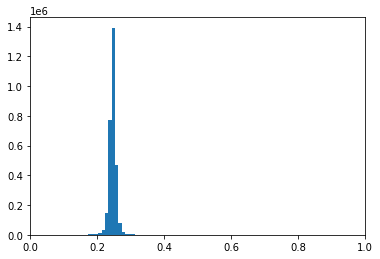

ocx median is:
0.24773898437188757


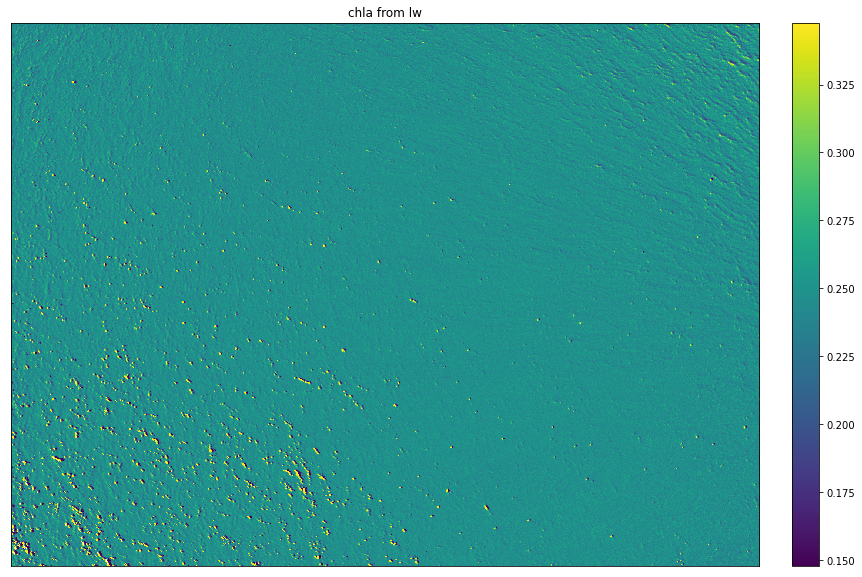

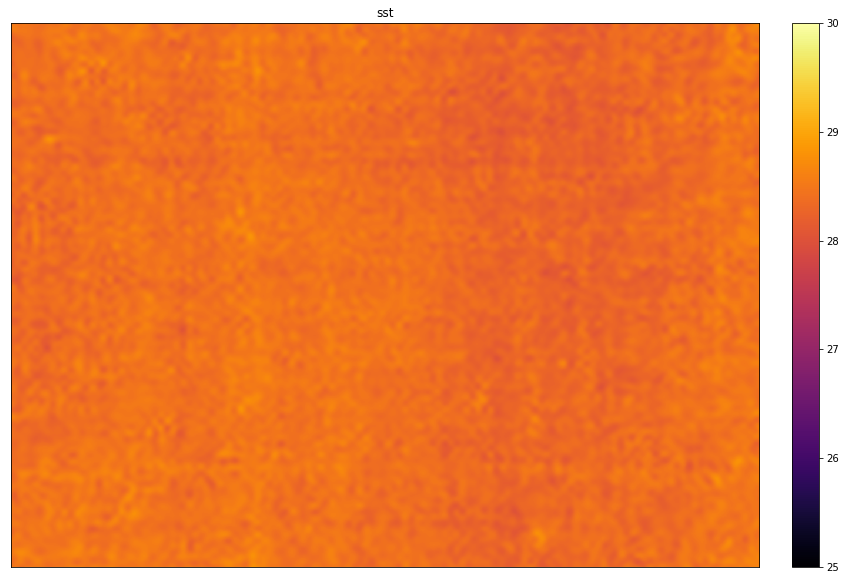

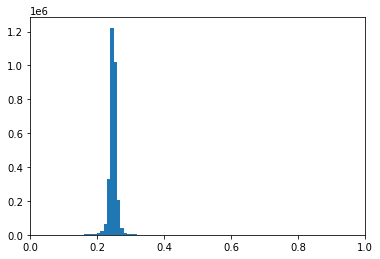

ocx median is:
0.2496862435268414


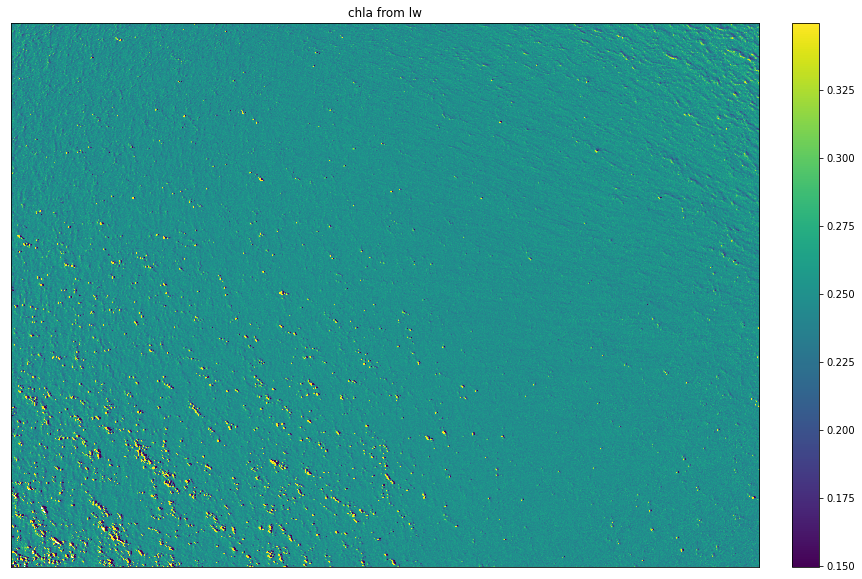

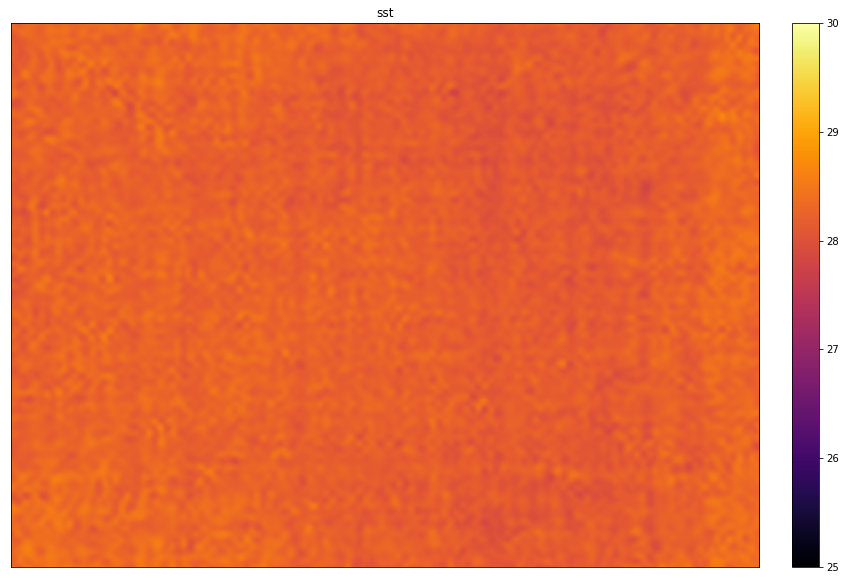

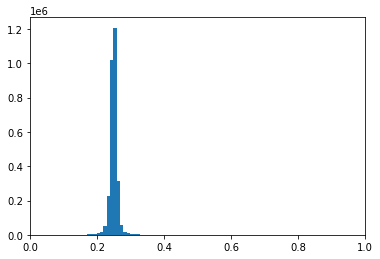

ocx median is:
0.250324384709399


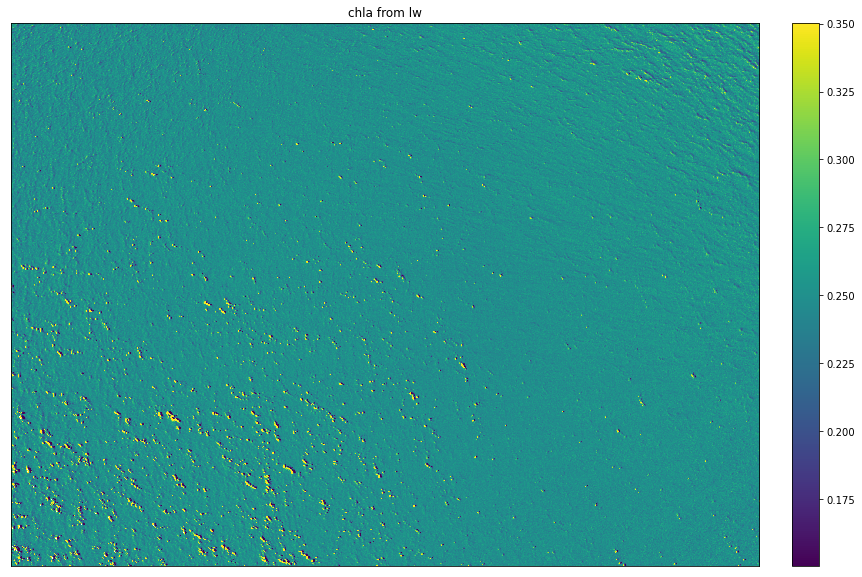

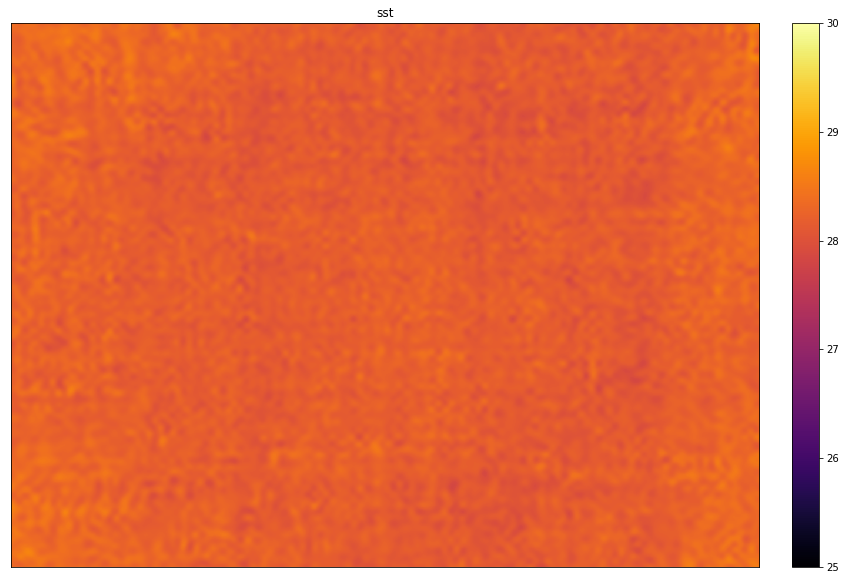

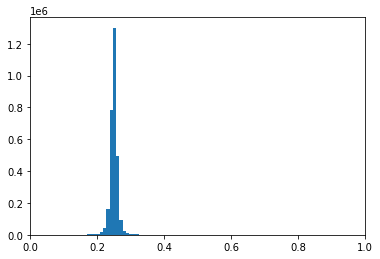

ocx median is:
0.25232761569492035


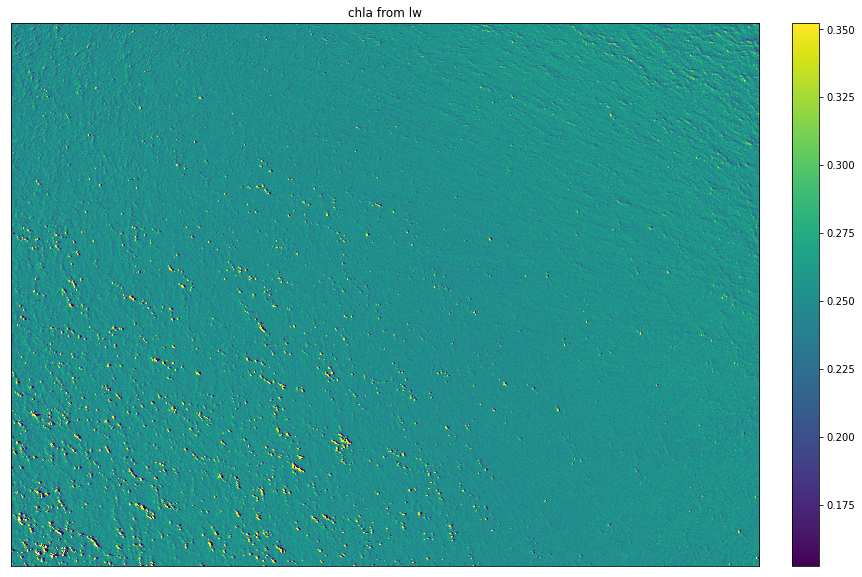

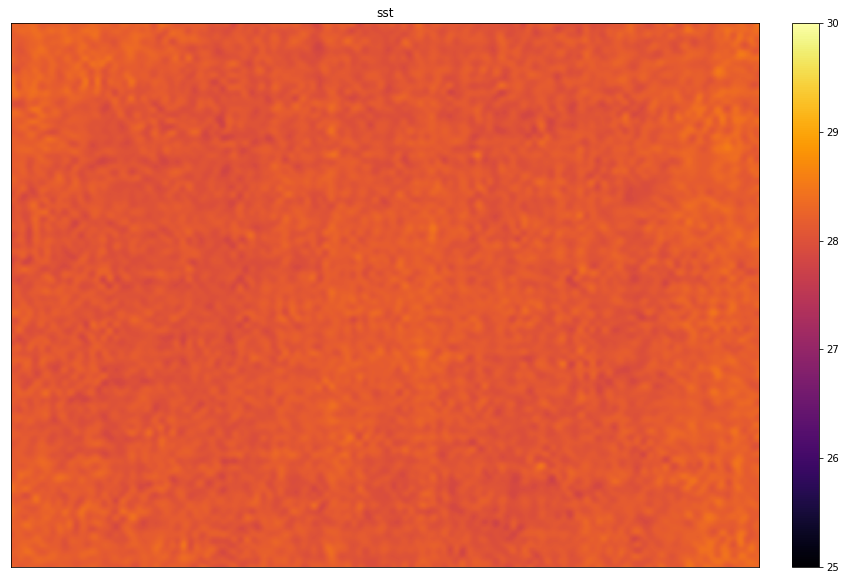

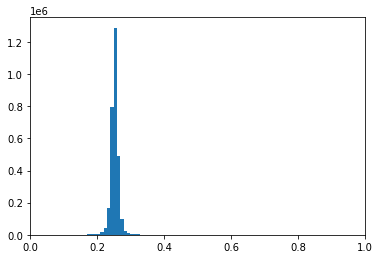

ocx median is:
0.2533388698843341


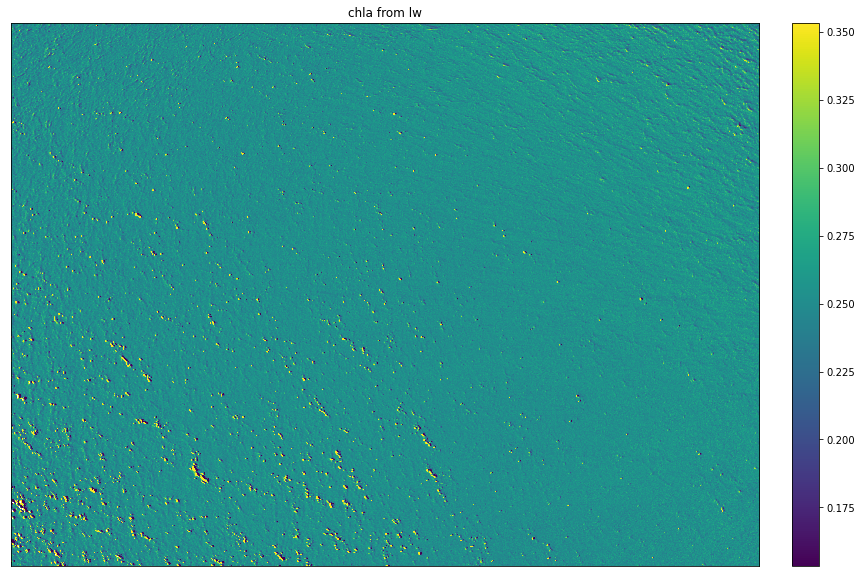

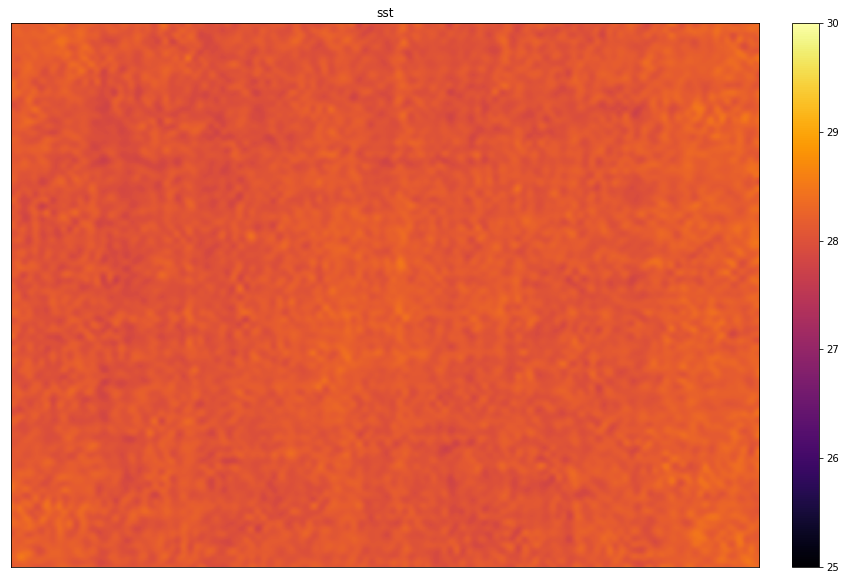

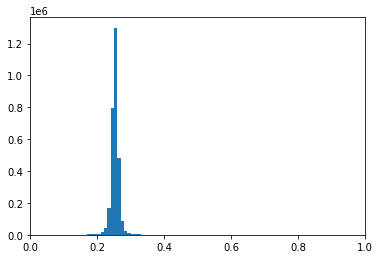

ocx median is:
0.25557251310261503


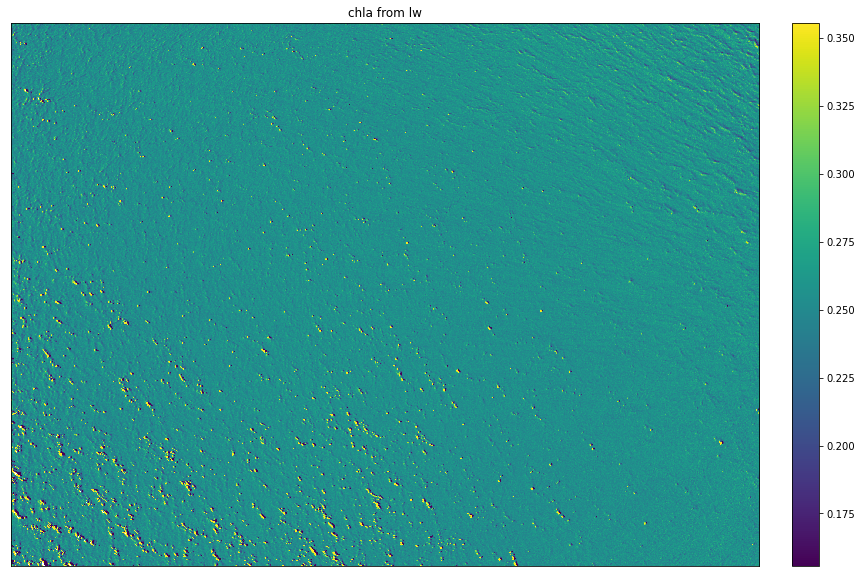

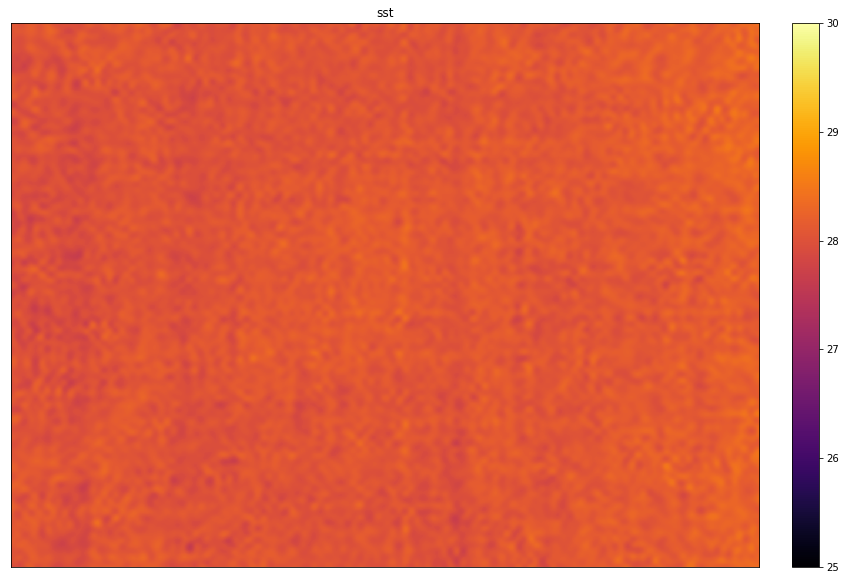

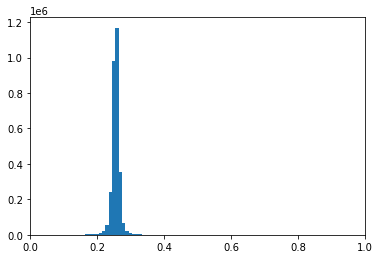

ocx median is:


KeyboardInterrupt: 

In [100]:
for i in range(1,30):
    
    img = sea_imgs[i,:5].copy() - smoothed_lt_lw
    #img[np.repeat((img[2] > 0.2)[np.newaxis,:,:],5,axis=0)] = np.nan
    img[np.repeat((img[0] < 0)[np.newaxis,:,:],5,axis=0)] = np.nan
        
    #chla_lw = vec_chla_img(img[0], img[1])
    #chla_lw = chla_lw[:500,:-1600]
    #img = img[:,:500,:-1600]    
    
    chla_oci = oc_index(img[0], img[1], img[2])
#     chla_oci = oc1_custom(img[0], img[1])
    chla_oci[chla_oci<0] = 0
    chla_oci[chla_oci>5] = np.nan
    
    img_median = np.nanmedian(img, axis=(1,2))
    print('ocx median is:')
    print(np.nanmedian(chla_oci))
    
    #print(vec_chla_img(img_median[0], img_median[1]))
    #print(np.nanmedian(chla_lw))
    fig, ax = plt.subplots(1, figsize=(15,10))
    im = ax.imshow(chla_oci,cmap='viridis', vmin=np.nanmedian(chla_oci)-.1, vmax=np.nanmedian(chla_oci)+.1, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('chla from lw')
    plt.show()
    
    
    sst = sea_imgs[i,5]*math.pi*32768/100-273.15
    fig, ax = plt.subplots(1, figsize=(15,10))
    im = ax.imshow(sst,cmap='inferno', vmin=25, vmax=30, interpolation='none')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title('sst')
    plt.show()
    
#     plt.hist(img[0].flatten(),bins=500)
#     plt.xlim(-.05,.05)
#     plt.show()
    
#     plt.hist(img[1].flatten(),bins=500)
#     plt.xlim(-.05,.05)
#     plt.show()

    plt.hist(chla_oci.flatten(), bins=500)
    plt.xlim(0,1)
    plt.show()


What does this look like slightly blurred?

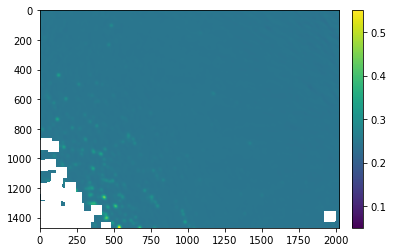

In [134]:
fig,ax = plt.subplots()
im = ax.imshow(ndimage.gaussian_filter(chla_oci, sigma=(9, 9), order=0), cmap='viridis', vmin=0.05, vmax=0.55, interpolation='none')
fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

Fill gaps just to see whole image

In [135]:
# TODO this is not the *ideal* solution
# make a mask where there are nans
mask = np.isnan(chla_oci)
# get the indices where the mask is not existant
idx = np.where(~mask,np.arange(mask.shape[1]),0)
np.maximum.accumulate(idx,axis=1, out=idx)
out = chla_oci[np.arange(idx.shape[0])[:,None], idx]

In [136]:
from scipy import interpolate
#mask invalid values
x = np.arange(0, chla_oci.shape[1])
y = np.arange(0, chla_oci.shape[0])
array = np.ma.masked_invalid(chla_oci)
xx, yy = np.meshgrid(x, y)
#get only the valid values
x1 = xx[~array.mask]
y1 = yy[~array.mask]
newarr = array[~array.mask]

GD1 = interpolate.griddata((x1, y1), newarr.ravel(),
                          (xx, yy),
                             method='nearest')

In [137]:
GD1.shape

(1470, 2023)

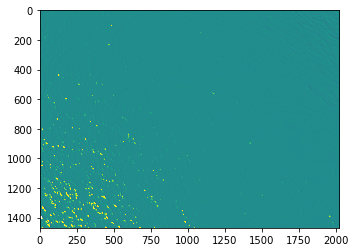

In [138]:
plt.imshow(out,cmap='viridis', vmin=0, vmax=.5)

Create a movie of all the data to watch change over time

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

KeyboardInterrupt: 

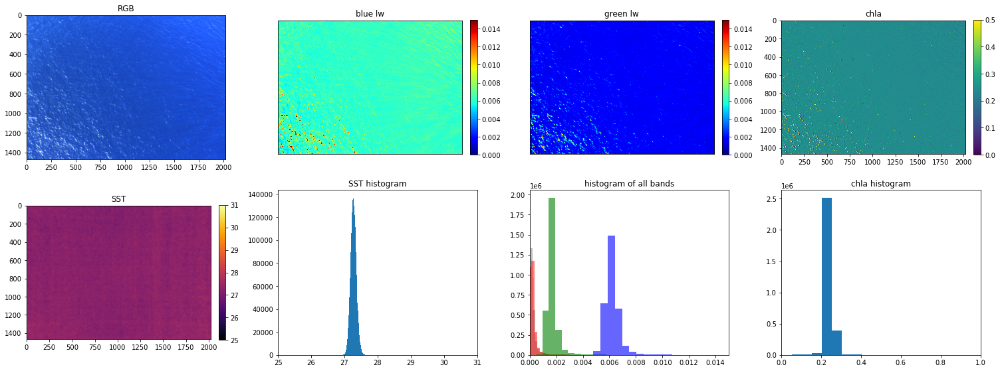

In [196]:
for i in range(90,len(mds)):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    sst=img[0,5]*math.pi*32768/100-273.15
    
    fig,ax = plt.subplots(2,4,figsize=(21,8))
    
    # RGB, blue, green, chla
    ax[0,0].imshow((np.transpose(img[0,0:3]/0.01, (1,2,0))[:,:,::-1]))
    ax[0,0].set_title('RGB')
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    chla_img = oc_index(img[0], img[1], img[2])
#     chla_img = oc1_custom(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>5] = np.nan
    #chla_img[chla_img<1] = np.nan
    
    im = ax[0,1].imshow(img[0],cmap='jet', vmin=0.0, vmax=.015)
    fig.colorbar(im, ax=ax[0,1], fraction=0.034, pad=0.04)
    ax[0,1].set_xticks([])
    ax[0,1].set_yticks([])
    ax[0,1].set_title('blue lw')
    im = ax[0,2].imshow(img[1],cmap='jet', vmin=0.0, vmax=.015)
    fig.colorbar(im, ax=ax[0,2], fraction=0.034, pad=0.04)
    ax[0,2].set_xticks([])
    ax[0,2].set_yticks([])
    ax[0,2].set_title('green lw')
    

    
    im = ax[0,3].imshow(chla_img, vmin=0,vmax=.5, interpolation='none')
    fig.colorbar(im, ax=ax[0,3], fraction=0.034, pad=0.04)
    ax[0,3].set_title('chla')
    
    # SST, SST hist, all bands hist, chla hist
    
    
    im = ax[1,0].imshow(sst,cmap='inferno', vmax=25,vmin=31)
    fig.colorbar(im, ax=ax[1,0], fraction=0.034, pad=0.04)
    ax[1,0].set_title('SST')
    
    ax[1,1].hist(sst.flatten(), bins=80)
    ax[1,1].set_xlim(25,31)
    ax[1,1].set_title('SST histogram')
    
    
    
    ax[1,2].hist((img[4]).flatten(), bins=100, color='rosybrown', alpha=0.2)
    ax[1,2].hist((img[3]).flatten(), bins=100, color='grey', alpha=0.5)
    ax[1,2].hist((img[2]).flatten(), bins=100, color='red', alpha=0.5)
    ax[1,2].hist((img[1]).flatten(), bins=100, color='green', alpha=0.6)
    ax[1,2].hist((img[0]).flatten(), bins=100, color='blue', alpha=0.6)
    ax[1,2].set_xlim(0,0.015)
    ax[1,2].set_title('histogram of all bands')
    
    ax[1,3].hist(chla_img.flatten(), bins=100)
    ax[1,3].set_xlim(0,1)
    ax[1,3].set_title('chla histogram')
    fig.tight_layout()
    
#     plt.show()

    fig.savefig('data/210827_A1_frontcross1/anims/full_analysis/img_sst_hist_bkg'+str(i).zfill(4)+'.png', 
                facecolor='white', edgecolor='none', transparent=False)   # save the figure to file
    fig.clear()
    plt.close(fig)  
    
    del img
    del sst
    del chla_img

##### Inspect the data geographically

Turn each image to a point and put it into a gdf

In [38]:
lats = []
lons = []
chla_list = []
chla_dates = []
temps = []
spectras = []
for i in range(50,len(mds)-50):
    img = retrieve_imgs_and_metadata(surface_dir, count=1, start=i, altitude_cutoff=0)[0]
    
    sst = img[0,5]
    sst_in_k = np.median(sst) *math.pi* 32768 / 100-273.15
#     plt.imshow(sst* 32768 / 100, vmin=288,vmax=292)
#     print(sst_in_k)
#     plt.show()
    
    img = img[0,:5,:,:] - smoothed_lt_lw
    #img = sea_imgs[i,:5].copy() 
    #img[np.repeat((img[2] > 0.0075)[np.newaxis,:,:],5,axis=0)] = np.nan
    chla_img = oc_index(img[0], img[1], img[2])
#     chla_img = oc1_custom(img[0], img[1])
    chla_img[chla_img<0] = 0
    chla_img[chla_img>5] = np.nan
    chla_med = np.nanmedian(chla_img)
    #img_median = np.nanmedian(img, axis=(1,2))
    #oc_med = oc_index(img_median[0], img_median[1], img_median[2])
    #oc_med = vec_chla_img(img_median[0], img_median[1])
    
    spectras.append(np.median(img,axis=[1,2]))

    chla_list.append(chla_med)
    lats.append(mds[i]['Latitude'])
    lons.append(mds[i]['Longitude'])
    chla_dates.append(datetime.datetime.strptime(mds[i]['Date']+' - '+mds[i]['UTC-Time'], '%m/%d/%Y - %H:%M:%S'))
    temps.append(sst_in_k)

In [39]:
len(chla_list)

407

<AxesSubplot:>

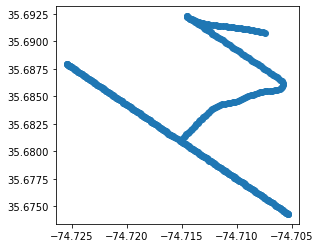

In [40]:
import geopandas as gpd
chla_df = pd.DataFrame(
    {'chla': chla_list,
     'Latitude': lats,
     'Longitude': lons,
     'time' : chla_dates,
     'sst' : temps,
     'lw_spectra': spectras
    })

chla_gdf = gpd.GeoDataFrame(
    chla_df, geometry=gpd.points_from_xy(chla_df.Longitude, chla_df.Latitude))
chla_gdf.plot()

<AxesSubplot:>

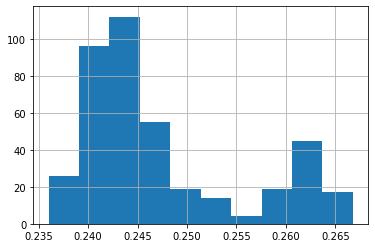

In [41]:
chla_gdf['chla'].hist()

<AxesSubplot:>

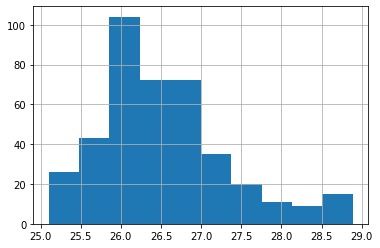

In [42]:
chla_gdf['sst'].hist()

In [43]:
chla_gdf_short = chla_gdf.iloc[:150]

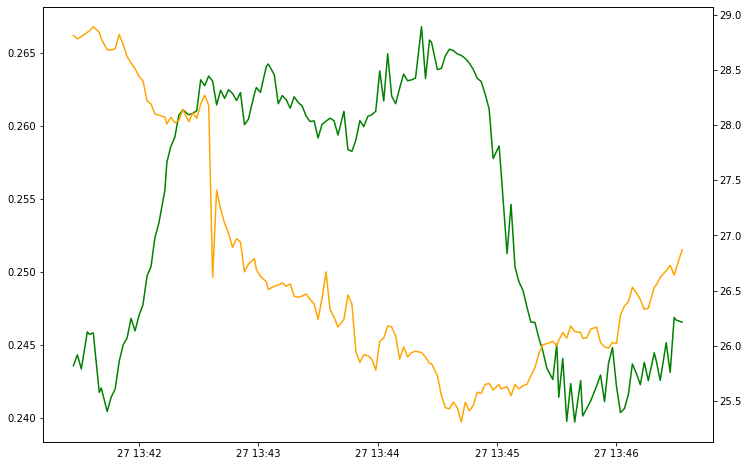

In [44]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf_short.time, chla_gdf_short.chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf_short.time, chla_gdf_short.sst, color='orange')

In [45]:
chla_gdf

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.243555,35.681433,-74.715933,2021-08-27 13:41:27,28.81,"[0.005836810136847615, 0.0014755155211726848, ...",POINT (-74.71593 35.68143)
1,0.244307,35.681528,-74.716067,2021-08-27 13:41:29,28.78,"[0.00581609908261339, 0.0014861911799454878, 0...",POINT (-74.71607 35.68153)
2,0.243333,35.681628,-74.716214,2021-08-27 13:41:31,28.80,"[0.005832722675011708, 0.0014656444567881658, ...",POINT (-74.71621 35.68163)
3,0.245878,35.681753,-74.716397,2021-08-27 13:41:34,28.84,"[0.005726428159208937, 0.0014757590615607032, ...",POINT (-74.71640 35.68175)
4,0.245712,35.681836,-74.716519,2021-08-27 13:41:35,28.85,"[0.005735854810761892, 0.0014762739736717944, ...",POINT (-74.71652 35.68184)
...,...,...,...,...,...,...,...
402,0.250364,35.690972,-74.708306,2021-08-27 13:55:11,25.20,"[0.005863768573913759, 0.0016871399693295834, ...",POINT (-74.70831 35.69097)
403,0.247254,35.690933,-74.708086,2021-08-27 13:55:13,25.17,"[0.006031752901044192, 0.0016997029109516453, ...",POINT (-74.70809 35.69093)
404,0.246122,35.690892,-74.707867,2021-08-27 13:55:15,25.10,"[0.006092535266905428, 0.001698661450383962, 0...",POINT (-74.70787 35.69089)
405,0.246245,35.690847,-74.707650,2021-08-27 13:55:17,25.32,"[0.006067710284533527, 0.0016867348870892663, ...",POINT (-74.70765 35.69085)


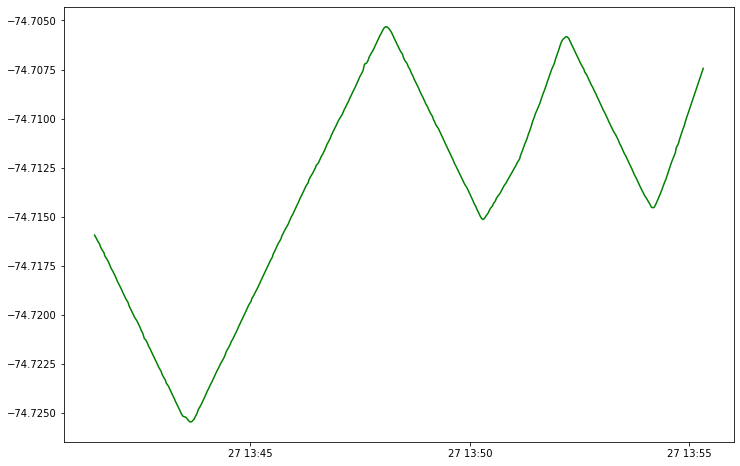

In [46]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='green')
# ax.plot(chla_gdf.time, chla_gdf.sst, color='orange')

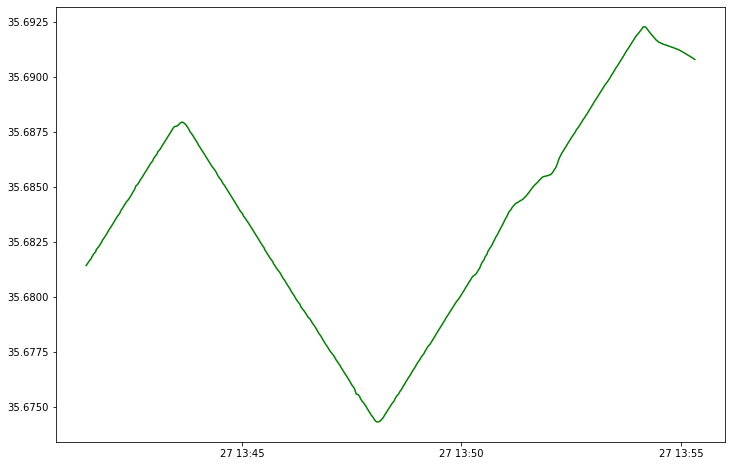

In [47]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Latitude, color='green')
# ax.plot(chla_gdf.time, chla_gdf.sst, color='orange')

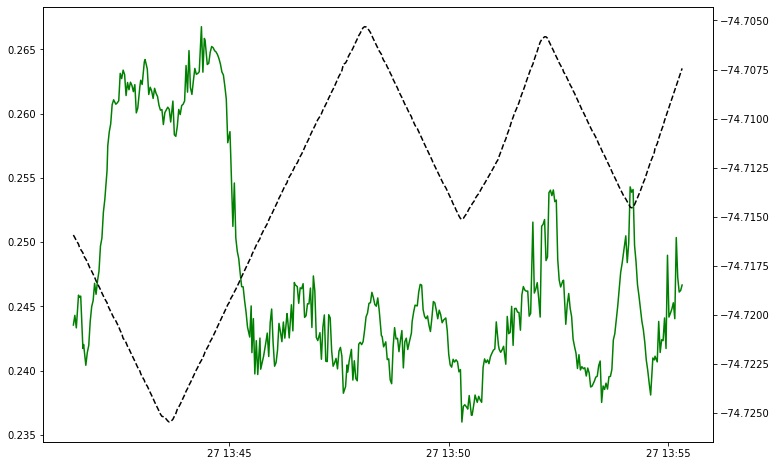

In [48]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='black', ls='--')


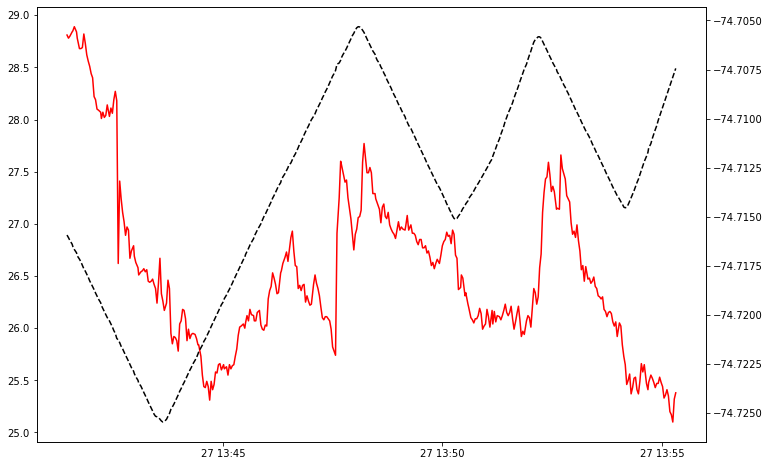

In [49]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].sst, color='red')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:].time, chla_gdf.iloc[:].Longitude, color='black', ls='--')

<AxesSubplot:>

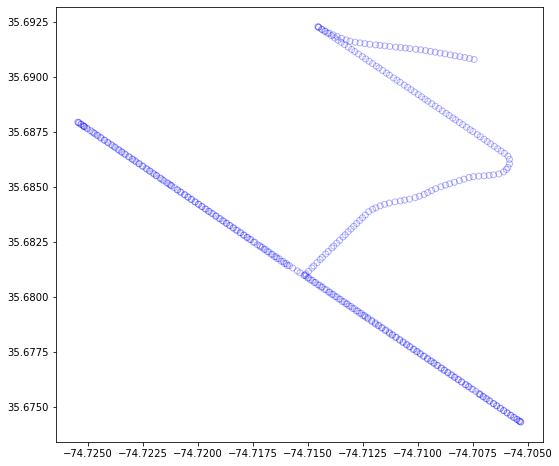

In [50]:
fig, ax = plt.subplots(figsize=(12,8))
chla_gdf.plot(alpha=0.3, ax=ax, facecolor='None', edgecolor='blue')

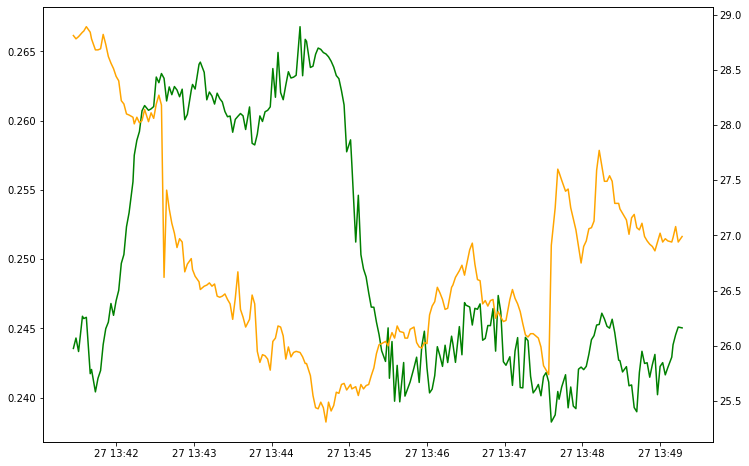

In [51]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(chla_gdf.iloc[:230].time, chla_gdf.iloc[:230].chla, color='green')
ax2=ax.twinx()
ax2.plot(chla_gdf.iloc[:230].time, chla_gdf.iloc[:230].sst, color='orange')

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/plotting.py:573: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  "Only specify one of 'column' or 'color'. Using 'color'.", UserWarning


<AxesSubplot:>

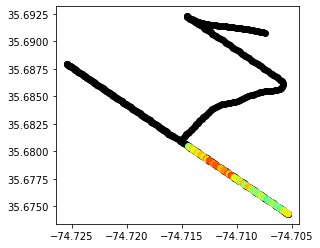

In [64]:
fig, ax = plt.subplots()
chla_gdf.iloc[:].plot('chla',vmin=0.26, vmax=.27, color='black', ax=ax)
chla_gdf.iloc[135:195].plot('chla',vmin=0.23, vmax=.25, cmap='jet', ax=ax)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/plotting.py:573: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  "Only specify one of 'column' or 'color'. Using 'color'.", UserWarning


<AxesSubplot:>

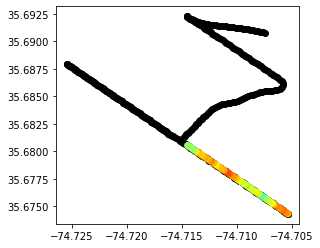

In [65]:
fig, ax = plt.subplots()
chla_gdf.iloc[:].plot('chla',vmin=0.26, vmax=.27, color='black', ax=ax)
chla_gdf.iloc[195:255].plot('chla',vmin=0.23, vmax=.25, cmap='jet', ax=ax)

(0.235, 0.27)

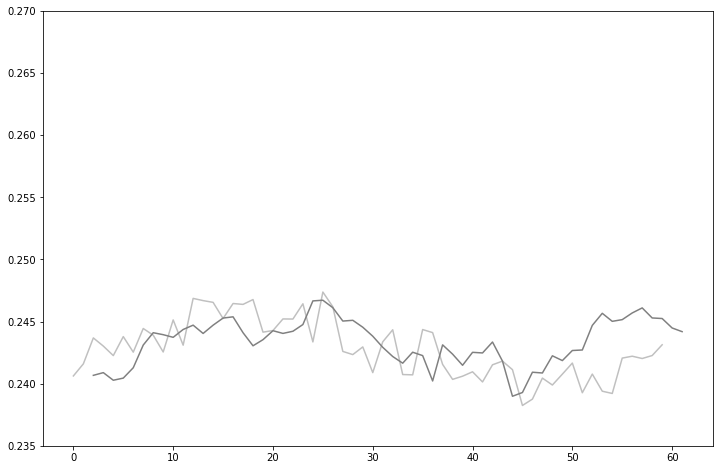

In [80]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(np.arange(0,60,1), chla_gdf.iloc[135:195].chla, color='silver')
ax.plot(np.arange(61,1,-1), chla_gdf.iloc[195:255].chla, color='grey')
# ax.plot(np.arange(0,28,1), chla_gdf.iloc[285:].chla, color='black')
ax.set_ylim(0.235,0.27)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/plotting.py:573: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  "Only specify one of 'column' or 'color'. Using 'color'.", UserWarning


<AxesSubplot:>

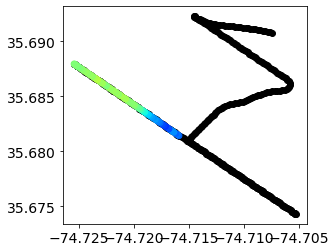

In [124]:
fig, ax = plt.subplots()
chla_gdf.iloc[:].plot('chla',vmin=0.26, vmax=.29, color='black', ax=ax)
chla_gdf.iloc[0:65].plot('chla',vmin=0.23, vmax=.29, cmap='jet', ax=ax)


/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/plotting.py:573: UserWarning: Only specify one of 'column' or 'color'. Using 'color'.
  "Only specify one of 'column' or 'color'. Using 'color'.", UserWarning


<AxesSubplot:>

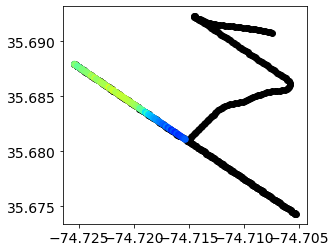

In [123]:
fig, ax = plt.subplots()
chla_gdf.iloc[:].plot('chla',vmin=0.26, vmax=.29, color='black', ax=ax)
chla_gdf.iloc[65:130].plot('chla',vmin=0.23, vmax=.29, cmap='jet', ax=ax)

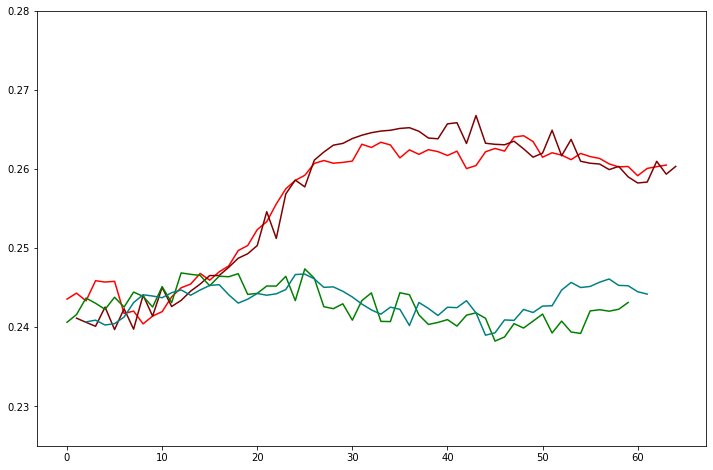

In [86]:
fig, ax = plt.subplots(figsize=(12,8))
ax.plot(np.arange(0,64,1), chla_gdf.iloc[0:64].chla, color='red')
ax.plot(np.arange(64,0,-1), chla_gdf.iloc[64:128].chla, color='maroon')
# ax.plot(np.arange(0,28,1), chla_gdf.iloc[285:].chla, color='black')

ax.plot(np.arange(0,60,1), chla_gdf.iloc[135:195].chla, color='green')
ax.plot(np.arange(61,1,-1), chla_gdf.iloc[195:255].chla, color='teal')
# ax.plot(np.arange(0,28,1), chla_gdf.iloc[285:].chla, color='black')

ax.set_ylim(0.225,0.28)

fig.savefig('oc_analysis_20210827_A1_gulf_stream_surveys_comparison_overlap.png')

<AxesSubplot:>

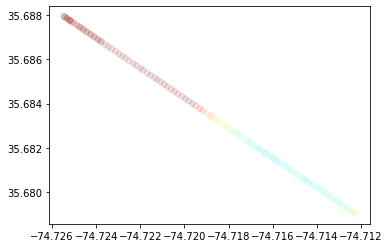

In [155]:
chla_gdf.iloc[50:150].plot('chla',vmin=0.23, vmax=.26, cmap='jet', alpha=0.1)

<AxesSubplot:>

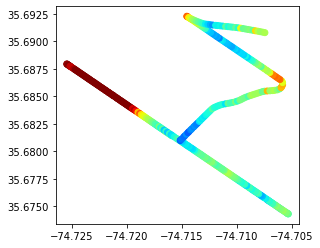

In [215]:
chla_gdf.iloc[:].plot('chla',vmin=0.23, vmax=.26, cmap='jet')

<AxesSubplot:>

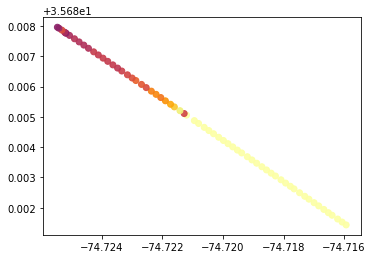

In [194]:
chla_gdf.iloc[0:65].plot(column='sst',vmin=25.5, vmax=27.5, cmap='inferno', alpha=0.9)

<AxesSubplot:>

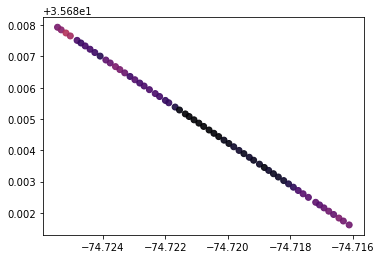

In [216]:
chla_gdf.iloc[65:125].plot(column='sst',vmin=25.5, vmax=27.5, cmap='inferno', alpha=0.9)

In [ ]:
chla_gdf.iloc[0:125].plot(column='sst',vmin=25.5, vmax=27.5, cmap='inferno', alpha=0.9)

<AxesSubplot:>

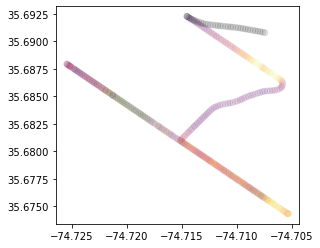

In [156]:
chla_gdf.plot(column=chla_gdf['sst'],vmin=25.5, vmax=27.5, cmap='inferno', alpha=0.1)

### Write out the data as .tifs

This step reprojects the data and georegisters it.

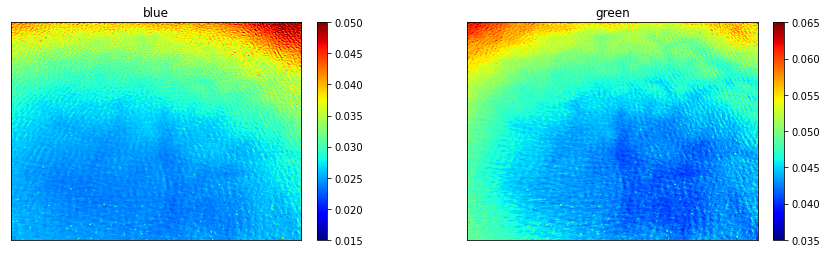

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[ 258.3914646  2348.50889259]
 [ 686.43797456  805.02304135]
 [1762.20844904 1473.83633639]
 [1525.06358628 2328.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 4000, 'height': 4000, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.6767996560071,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7147809111126), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


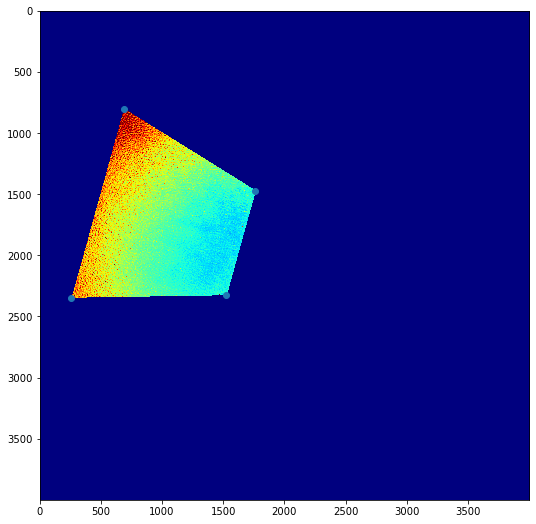

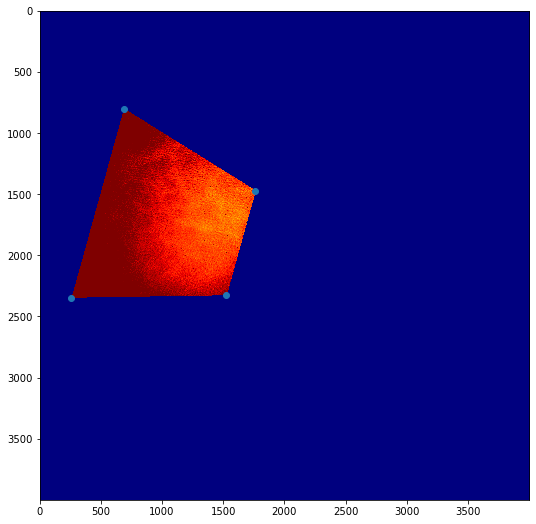

In [59]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-100,100,-100,100]
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    resized_blue[resized_blue < 0] = 0
    resized_green[resized_green < 0] = 0
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

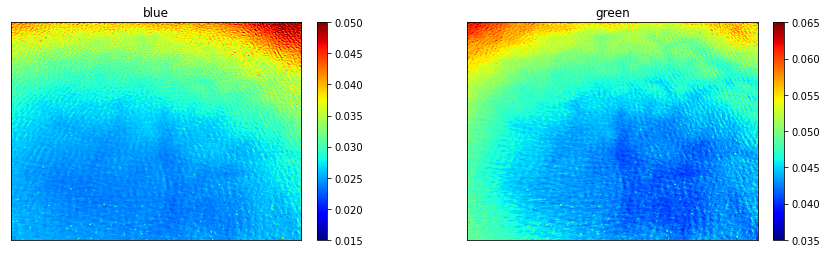

/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


34.7138816 -76.6757056 47.83 -74.5 0 40
0.05
img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  blue_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!
34.7138816 -76.6757056 47.83 -74.5 0 40
0.05


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3427: FutureWarning: Indexing a timezone-naive DatetimeIndex with a timezone-aware datetime is deprecated and will raise KeyError in a future version.  Use a timezone-naive object instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


img coords:  [[-441.6085354  1548.50889259]
 [ -13.56202544    5.02304135]
 [1062.20844904  673.83633639]
 [ 825.06358628 1528.95308621]]
initial profile
{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 2064, 'height': 1544, 'count': 1, 'crs': None, 'transform': Affine(1.0, 0.0, 0.0,
       0.0, 1.0, 0.0), 'tiled': False, 'interleave': 'band'}
updated profile
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 2600, 'height': 2400, 'count': 1, 'crs': 'EPSG:4326', 'transform': Affine(3.5185429974500584e-12, 5.470247326852344e-07, -76.67641673587939,
       -4.4965761414818946e-07, 2.387899005108411e-12, 34.7144211866928), 'tiled': False, 'interleave': 'band'}
written out as  green_georeg_finerLKLBZ1Ww6EphUE56L9ZR.tif
Complete!


/home/clifgray/Code/ocean_color/georeg.py:66: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  
/home/clifgray/anaconda3/envs/micasense_ocean_color/lib/python3.7/site-packages/rasterio/__init__.py:218: NotGeoreferencedWarning: Dataset has no geotransform set. The identity matrix may be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


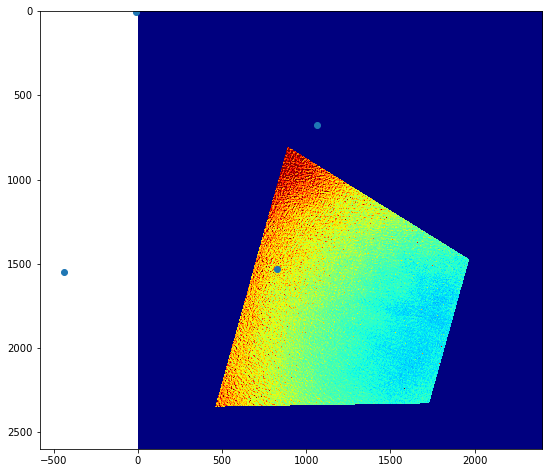

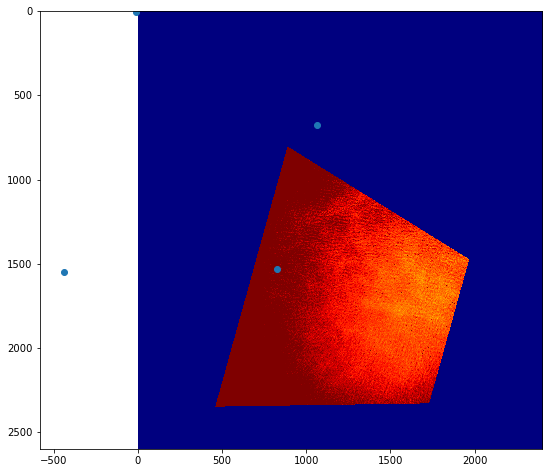

In [58]:
from skimage.transform import resize

for i in range(15):
    
    # form is [x_min, x_max, y_min, y_max]
    top_im_bounds=[-110,10,-30,100]
    x_center_offset = 10 - 110 / 0.05
    
    original_img = plt.imread(sea_img_metadata[i]['image_name'])
    resized_blue = resize(sea_imgs[i,0], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    resized_green = resize(sea_imgs[i,1], (original_img.shape[0], original_img.shape[1]), anti_aliasing=True)
    
    fig, ax = plt.subplots(1,2, figsize=(15,4))
    im = ax[0].imshow(resized_blue,cmap='jet', vmin=0.015, vmax=.05)
    fig.colorbar(im, ax=ax[0], fraction=0.046, pad=0.04)
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[0].set_title('blue')
    
    im = ax[1].imshow(resized_green,cmap='jet', vmin=0.035, vmax=.065)
    fig.colorbar(im, ax=ax[1], fraction=0.046, pad=0.04)
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_title('green')
    plt.show()
    new_name = 'blue_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_blue, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    new_name = 'green_georeg_finer' + sea_img_metadata[i]['filename']
    alta_micasense_georef(sea_img_metadata[i]['image_name'], new_name, resized_green, alta_logs, top_im_bounds=top_im_bounds, scaling=0.05)
    
    break

## compare this to the Trios Data

If the data exists, otherwise skip or delete this section.

First find the start and stop time of the UAS imagery.

In [62]:
from datetime import datetime
import geopandas as gpd
import pandas as pd

In [90]:
def dms2dd(degrees, minutes, seconds, direction):
    dd = degrees + minutes/60 + seconds/(60*60);
    if direction == 'W' or direction == 'S':
        dd *= -1
    return dd;

In [91]:
ship_df = pd.read_csv('../gs_front_analysis/data/ivan_data/tsg_gps/Navigation/SW-GGA_20210825-082425.Raw', index_col=None,
                 names=['date', 'time','spacer', 'idk', 'SW-GGA-Lat','latdir', 'SW-GGA-Long', 'londir', 'a','b','c','d','e','f','g'])

date_time_strs = ship_df['date'] + ' ' + ship_df['time']

ship_df['datetime'] = [datetime.datetime.strptime(x, '%m/%d/%Y %H:%M:%S.%f') for x in date_time_strs]
ship_df['utc_dt'] = ship_df['datetime']+ timedelta(minutes=4)
ship_df  = ship_df.set_index('utc_dt')

ship_df['lon'] = dms2dd(pd.to_numeric(ship_df['SW-GGA-Long'].astype(str).str[:2]).astype(float), pd.to_numeric(ship_df['SW-GGA-Long'].astype(str).str[2:]),np.array(0), 'W')
ship_df['lat'] = dms2dd(pd.to_numeric(ship_df['SW-GGA-Lat'].astype(str).str[:2]).astype(float), pd.to_numeric(ship_df['SW-GGA-Lat'].astype(str).str[2:]),np.array(0), 'E')


ship_gdf = gpd.GeoDataFrame(
    ship_df, geometry=gpd.points_from_xy(ship_df.lon, ship_df.lat))

In [92]:
ship_gdf.head()

,date,time,spacer,idk,SW-GGA-Lat,latdir,SW-GGA-Long,londir,a,b,c,d,e,f,g,datetime,lon,lat,geometry
utc_dt,,,,,,,,,,,,,,,,,,,
2021-08-25 08:28:30.412,08/25/2021,08:24:30.412,$GPGGA,82741.69,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*43,2021-08-25 08:24:30.412,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:31.506,08/25/2021,08:24:31.506,$GPGGA,82742.69,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*40,2021-08-25 08:24:31.506,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:32.287,08/25/2021,08:24:32.287,$GPGGA,82743.70,3443.0547,N,7640.2343,W,2,29,0.5,-28.5,M,-36.8,M*79,2021-08-25 08:24:32.287,-76.670572,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:33.709,08/25/2021,08:24:33.709,$GPGGA,82744.70,3443.0547,N,7640.2342,W,2,29,0.5,-28.5,M,-36.8,M*7F,2021-08-25 08:24:33.709,-76.670570,34.717578,POINT (-76.67057 34.71758)
2021-08-25 08:28:34.631,08/25/2021,08:24:34.631,$GPGGA,82745.70,3443.0547,N,7640.2342,W,2,28,0.5,-28.4,M,-36.8,M*7E,2021-08-25 08:24:34.631,-76.670570,34.717578,POINT (-76.67057 34.71758)


<AxesSubplot:>

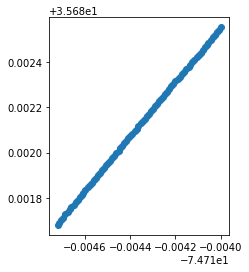

In [93]:
ship_gdf.loc['2021-08-27 13:41:27':'2021-08-27 13:42:47'].plot()

In [94]:
sea_img_metadata[0]['UTC-Time'], sea_img_metadata[len(sea_img_metadata)-1]['UTC-Time']

('13:41:27', '13:42:47')

Pull in the trios data based on that day.

In [95]:
trios_fns = [
    '../gs_front_analysis/data/ivan_data/trios/shearwater_trios_20210827.csv',

            ]
trios_dfs = []
for fn in trios_fns:
    trios_dfs.append(pd.read_csv(fn))

trios_df = pd.DataFrame().append(trios_dfs)

Combine the Ship GPS with TriOS based on time

In [96]:
trios_df['datetime'] = pd.to_datetime(trios_df['TimeStamp'])
trios_df['utc_dt'] =trios_df['datetime'] + timedelta(hours=4) # moving it to UTC
trios_df = trios_df.set_index('utc_dt')

In [97]:
lats = []
lons = []
for i in range(len(trios_df)):
    item = trios_df.iloc[i]
    img_idx = ship_gdf.index.get_loc(item['datetime'] + timedelta(hours=4), method='nearest')
    lats.append(ship_gdf.iloc[img_idx]['lat'])
    lons.append(ship_gdf.iloc[img_idx]['lon'])

In [98]:
trios_df['lat'] = lats
trios_df['lon'] = lons

<AxesSubplot:>

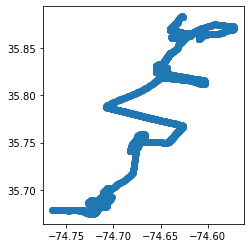

In [99]:
trios_gdf = gpd.GeoDataFrame(
    trios_df, geometry=gpd.points_from_xy(trios_df.lon, trios_df.lat))
trios_gdf.plot()

Trim the data to the flight time and closest locations.

In [100]:
chla_gdf.head(1)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.243555,35.681433,-74.715933,2021-08-27 13:41:27,28.81,"[0.005836810136847615, 0.0014755155211726848, ...",POINT (-74.71593 35.68143)


In [101]:
trios_gdf_transect = trios_gdf.loc[chla_gdf.iloc[0]['time']:chla_gdf.iloc[len(chla_gdf)-1]['time']]

In [102]:
chla_gdf.iloc[0].lw_spectra

array([0.00583681, 0.00147552, 0.00016475, 0.00011772, 0.00017712])

In [103]:
chla_gdf

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.243555,35.681433,-74.715933,2021-08-27 13:41:27,28.81,"[0.005836810136847615, 0.0014755155211726848, ...",POINT (-74.71593 35.68143)
1,0.244307,35.681528,-74.716067,2021-08-27 13:41:29,28.78,"[0.00581609908261339, 0.0014861911799454878, 0...",POINT (-74.71607 35.68153)
2,0.243333,35.681628,-74.716214,2021-08-27 13:41:31,28.80,"[0.005832722675011708, 0.0014656444567881658, ...",POINT (-74.71621 35.68163)
3,0.245878,35.681753,-74.716397,2021-08-27 13:41:34,28.84,"[0.005726428159208937, 0.0014757590615607032, ...",POINT (-74.71640 35.68175)
4,0.245712,35.681836,-74.716519,2021-08-27 13:41:35,28.85,"[0.005735854810761892, 0.0014762739736717944, ...",POINT (-74.71652 35.68184)
...,...,...,...,...,...,...,...
402,0.250364,35.690972,-74.708306,2021-08-27 13:55:11,25.20,"[0.005863768573913759, 0.0016871399693295834, ...",POINT (-74.70831 35.69097)
403,0.247254,35.690933,-74.708086,2021-08-27 13:55:13,25.17,"[0.006031752901044192, 0.0016997029109516453, ...",POINT (-74.70809 35.69093)
404,0.246122,35.690892,-74.707867,2021-08-27 13:55:15,25.10,"[0.006092535266905428, 0.001698661450383962, 0...",POINT (-74.70787 35.69089)
405,0.246245,35.690847,-74.707650,2021-08-27 13:55:17,25.32,"[0.006067710284533527, 0.0016867348870892663, ...",POINT (-74.70765 35.69085)


In [104]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return(chla_gdf[nearest].Latitude.values[0])

trios_gdf_transect['uas_lat'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return(chla_gdf[nearest].Longitude.values[0])

trios_gdf_transect['uas_lon'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,947,948,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 13:41:30,08/27/2021 09:41:30,0.007324,0.007137,0.007072,0.007001,0.006959,0.006914,0.006900,0.006971,0.007069,...,0.000281,0.000227,0.000174,0.000175,2021-08-27 09:41:30,35.681712,-74.714698,POINT (-74.71470 35.68171),35.681567,-74.714581
2021-08-27 13:41:40,08/27/2021 09:41:40,0.005828,0.005658,0.005589,0.005542,0.005522,0.005498,0.005477,0.005529,0.005610,...,0.000124,0.000073,0.000021,-0.000008,2021-08-27 09:41:40,35.681823,-74.714608,POINT (-74.71461 35.68182),35.681706,-74.714444


In [105]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return chla_gdf[nearest].lw_spectra.values[0]

trios_gdf_transect['uas_spec'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,948,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 13:41:30,08/27/2021 09:41:30,0.007324,0.007137,0.007072,0.007001,0.006959,0.006914,0.006900,0.006971,0.007069,...,0.000227,0.000174,0.000175,2021-08-27 09:41:30,35.681712,-74.714698,POINT (-74.71470 35.68171),35.681567,-74.714581,"[0.006614697174505688, 0.0017623408652392212, ..."
2021-08-27 13:41:40,08/27/2021 09:41:40,0.005828,0.005658,0.005589,0.005542,0.005522,0.005498,0.005477,0.005529,0.005610,...,0.000073,0.000021,-0.000008,2021-08-27 09:41:40,35.681823,-74.714608,POINT (-74.71461 35.68182),35.681706,-74.714444,"[0.006487733436632146, 0.0016427075924402722, ..."


In [106]:
from shapely.ops import nearest_points
# unary union of the gpd2 geomtries 
pts3 = chla_gdf.geometry.unary_union

def near(point, pts=pts3):
    # find the nearest point and return the corresponding Place value
    nearest = chla_gdf.geometry == nearest_points(point, pts)[1]
    return chla_gdf[nearest].chla.values[0]

trios_gdf_transect['uas_chla'] = trios_gdf_transect.apply(lambda row: near(row.geometry), axis=1)
trios_gdf_transect.head(2)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


,TimeStamp,320,321,322,323,324,325,326,327,328,...,949,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 13:41:30,08/27/2021 09:41:30,0.007324,0.007137,0.007072,0.007001,0.006959,0.006914,0.006900,0.006971,0.007069,...,0.000174,0.000175,2021-08-27 09:41:30,35.681712,-74.714698,POINT (-74.71470 35.68171),35.681567,-74.714581,"[0.006614697174505688, 0.0017623408652392212, ...",0.238066
2021-08-27 13:41:40,08/27/2021 09:41:40,0.005828,0.005658,0.005589,0.005542,0.005522,0.005498,0.005477,0.005529,0.005610,...,0.000021,-0.000008,2021-08-27 09:41:40,35.681823,-74.714608,POINT (-74.71461 35.68182),35.681706,-74.714444,"[0.006487733436632146, 0.0016427075924402722, ...",0.236531


In [107]:
pip install geopy

Note: you may need to restart the kernel to use updated packages.


In [108]:
import geopy.distance
def dist_fcn(sample_lat,sample_lon,uas_lat,uas_lon):
    coords_1 = (sample_lat, sample_lon)
    coords_2 = (uas_lat, uas_lon)
    return(geopy.distance.distance(coords_1, coords_2).km)
trios_gdf_transect['pt_dist'] = trios_gdf_transect.apply(lambda row: dist_fcn(row['lat'],row['lon'],row['uas_lat'],row['uas_lon']), axis=1)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


(array([16., 18., 10.,  8.,  8.,  5.,  5.,  3.,  4.,  5.]),
 array([0.00397557, 0.02846422, 0.05295287, 0.07744151, 0.10193016,
        0.12641881, 0.15090746, 0.1753961 , 0.19988475, 0.2243734 ,
        0.24886205]),
 <BarContainer object of 10 artists>)

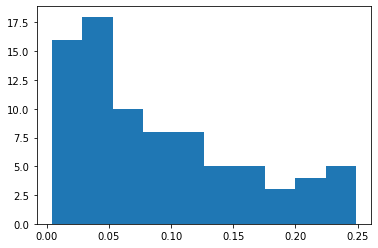

In [109]:
plt.hist(trios_gdf_transect.pt_dist)

In [111]:
matched_subset = trios_gdf_transect[trios_gdf_transect.pt_dist < 0.05]
len(matched_subset)

34

In [112]:
matched_subset

,TimeStamp,320,321,322,323,324,325,326,327,328,...,950,datetime,lat,lon,geometry,uas_lat,uas_lon,uas_spec,uas_chla,pt_dist
utc_dt,,,,,,,,,,,,,,,,,,,,,
2021-08-27 13:41:30,08/27/2021 09:41:30,0.007324,0.007137,0.007072,0.007001,0.006959,0.006914,0.006900,0.006971,0.007069,...,0.000175,2021-08-27 09:41:30,35.681712,-74.714698,POINT (-74.71470 35.68171),35.681567,-74.714581,"[0.006614697174505688, 0.0017623408652392212, ...",0.238066,0.019300
2021-08-27 13:41:40,08/27/2021 09:41:40,0.005828,0.005658,0.005589,0.005542,0.005522,0.005498,0.005477,0.005529,0.005610,...,-0.000008,2021-08-27 09:41:40,35.681823,-74.714608,POINT (-74.71461 35.68182),35.681706,-74.714444,"[0.006487733436632146, 0.0016427075924402722, ...",0.236531,0.019771
2021-08-27 13:41:50,08/27/2021 09:41:50,0.008507,0.008319,0.008259,0.008183,0.008136,0.008083,0.008048,0.008099,0.008179,...,0.000542,2021-08-27 09:41:50,35.681933,-74.714517,POINT (-74.71452 35.68193),35.681806,-74.714342,"[0.006460961975521486, 0.0016241721115546467, ...",0.236537,0.021259
2021-08-27 13:42:00,08/27/2021 09:42:00,0.005225,0.005080,0.005026,0.004968,0.004940,0.004909,0.004892,0.004949,0.005033,...,0.000169,2021-08-27 09:42:00,35.682042,-74.714427,POINT (-74.71443 35.68204),35.681956,-74.714192,"[0.006508289185596333, 0.00168033730267397, 0....",0.237636,0.023320
2021-08-27 13:42:10,08/27/2021 09:42:10,0.007190,0.007014,0.006947,0.006876,0.006832,0.006783,0.006755,0.006809,0.006893,...,0.000327,2021-08-27 09:42:10,35.682150,-74.714335,POINT (-74.71434 35.68215),35.681956,-74.714192,"[0.006508289185596333, 0.00168033730267397, 0....",0.237636,0.025175
2021-08-27 13:42:20,08/27/2021 09:42:20,0.005845,0.005666,0.005593,0.005535,0.005505,0.005472,0.005452,0.005506,0.005589,...,-0.000023,2021-08-27 09:42:20,35.682258,-74.714245,POINT (-74.71425 35.68226),35.682069,-74.714078,"[0.006500271276381917, 0.0016924429846708073, ...",0.238107,0.025853
2021-08-27 13:42:30,08/27/2021 09:42:30,0.005617,0.005440,0.005367,0.005314,0.005289,0.005259,0.005239,0.005294,0.005379,...,-0.000036,2021-08-27 09:42:30,35.682368,-74.714152,POINT (-74.71415 35.68237),35.682231,-74.713914,"[0.006361733643378039, 0.0015920603786573101, ...",0.237537,0.026401
2021-08-27 13:42:40,08/27/2021 09:42:40,0.005971,0.005817,0.005756,0.005698,0.005666,0.005631,0.005615,0.005675,0.005763,...,-0.000030,2021-08-27 09:42:40,35.682475,-74.714062,POINT (-74.71406 35.68247),35.682319,-74.713825,"[0.00634715871193373, 0.0015987391371396428, 0...",0.238005,0.027511
2021-08-27 13:42:50,08/27/2021 09:42:50,0.006405,0.006214,0.006143,0.006102,0.006083,0.006058,0.006040,0.006098,0.006187,...,0.000632,2021-08-27 09:42:50,35.682587,-74.713972,POINT (-74.71397 35.68259),35.682319,-74.713825,"[0.00634715871193373, 0.0015987391371396428, 0...",0.238005,0.032486


In [113]:
matched_subset.columns[1:-10]

Index(['320', '321', '322', '323', '324', '325', '326', '327', '328', '329',
       ...
       '940', '941', '942', '943', '944', '945', '946', '947', '948', '949'],
      dtype='object', length=630)

In [114]:
plt.rcParams.update({'font.size': 14})

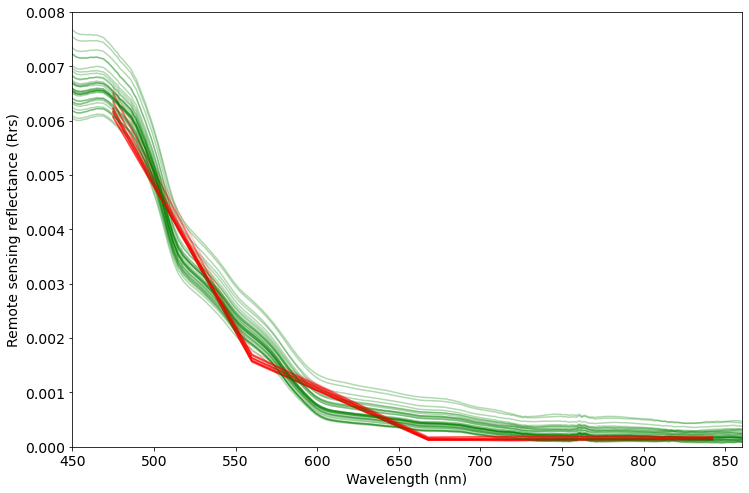

In [115]:
fig,ax = plt.subplots(figsize=(12,8))
for i in range(len(matched_subset)):
    ax.plot(matched_subset.columns[1:-11].astype(int),matched_subset.iloc[i,1:-11], color='green', alpha=0.3)
    ax.plot([475, 560, 668, 717, 842],matched_subset.iloc[i].uas_spec, color='red', alpha=0.2)
ax.set_xlim(450,860)
ax.set_ylim(0,0.008)
ax.set_ylabel('Remote sensing reflectance (Rrs)')
ax.set_xlabel('Wavelength (nm)')
fig.savefig('oc_analysis_20210827_A1_gulf_stream_surveys_comparing_trios_to_altum.png',dpi=300)

In [118]:
matched_subset['chla_oci'] = oc_index(matched_subset.iloc[:, 156:161].mean(axis=1).values, matched_subset.iloc[:, 232:240].mean(axis=1).values, matched_subset.iloc[:, 346:351].mean(axis=1).values)

/home/clifgray/anaconda3/envs/micasense/lib/python3.7/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


(0.001, 0.008)

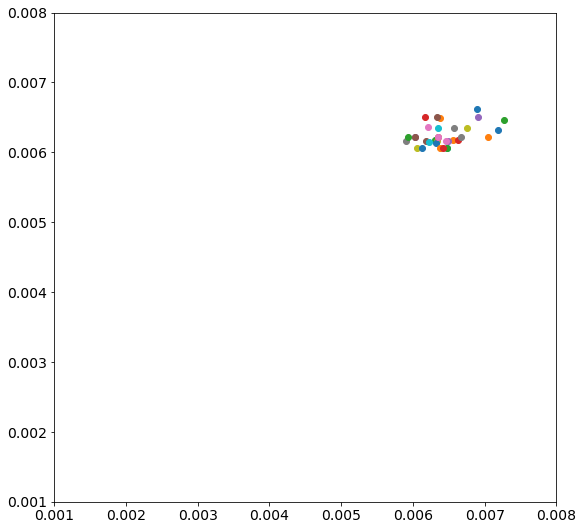

In [116]:
fig,ax = plt.subplots(figsize=(9,9))
for i in range(len(matched_subset)):
    ax.scatter(matched_subset.iloc[i, 156:161].mean(),matched_subset.iloc[i].uas_spec[0])
#     ax.plot(matched_subset.columns[1:-11].astype(int),matched_subset.iloc[i,1:-11], color='green', alpha=0.3)
#     ax.plot([475, 560, 668, 717, 842],matched_subset.iloc[i].uas_spec, color='red', alpha=0.2)
ax.set_xlim(0.001,0.008)
ax.set_ylim(0.001,0.008)
# ax.set_ylabel('Remote sensing reflectance (Rrs)')
# ax.set_xlabel('Wavelength (nm)')
# fig.savefig('comparing_trios_to_altum.png',dpi=300)

(0.0, 0.3)

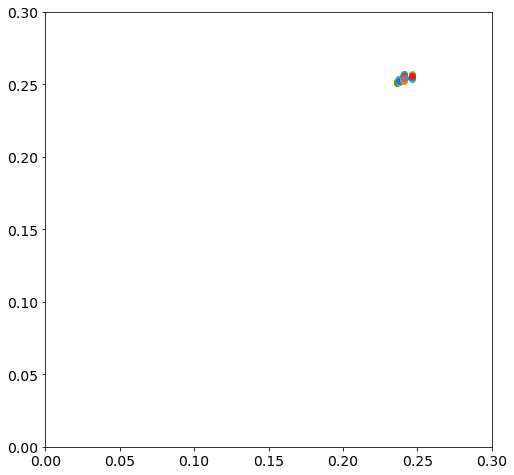

In [119]:
fig, ax = plt.subplots(figsize=(8,8))
for i in range(len(matched_subset)):
    plt.scatter(matched_subset.iloc[i].uas_chla, matched_subset.iloc[i].chla_oci)
plt.xlim(0,.3)
plt.ylim(0,.3)

,chla,Latitude,Longitude,time,sst,lw_spectra,geometry
0,0.243555,35.681433,-74.715933,2021-08-27 13:41:27,28.81,"[0.005836810136847615, 0.0014755155211726848, ...",POINT (-74.71593 35.68143)
1,0.244307,35.681528,-74.716067,2021-08-27 13:41:29,28.78,"[0.00581609908261339, 0.0014861911799454878, 0...",POINT (-74.71607 35.68153)
2,0.243333,35.681628,-74.716214,2021-08-27 13:41:31,28.80,"[0.005832722675011708, 0.0014656444567881658, ...",POINT (-74.71621 35.68163)
3,0.245878,35.681753,-74.716397,2021-08-27 13:41:34,28.84,"[0.005726428159208937, 0.0014757590615607032, ...",POINT (-74.71640 35.68175)
4,0.245712,35.681836,-74.716519,2021-08-27 13:41:35,28.85,"[0.005735854810761892, 0.0014762739736717944, ...",POINT (-74.71652 35.68184)
...,...,...,...,...,...,...,...
402,0.250364,35.690972,-74.708306,2021-08-27 13:55:11,25.20,"[0.005863768573913759, 0.0016871399693295834, ...",POINT (-74.70831 35.69097)
403,0.247254,35.690933,-74.708086,2021-08-27 13:55:13,25.17,"[0.006031752901044192, 0.0016997029109516453, ...",POINT (-74.70809 35.69093)
404,0.246122,35.690892,-74.707867,2021-08-27 13:55:15,25.10,"[0.006092535266905428, 0.001698661450383962, 0...",POINT (-74.70787 35.69089)
405,0.246245,35.690847,-74.707650,2021-08-27 13:55:17,25.32,"[0.006067710284533527, 0.0016867348870892663, ...",POINT (-74.70765 35.69085)


In [125]:
cgdf_copy = chla_gdf.copy()
cgdf_copy['time_str'] = cgdf_copy['time'].astype(str)
cgdf_copy['lw_spectra'] = cgdf_copy['lw_spectra'].astype(str)
cgdf_copy.drop('time', 1).to_file('data/oc_analysis_20210827_A1_gulf_stream_surveys.shp')

In [126]:
mgdf_copy = matched_subset.copy()

mgdf_copy['time_str'] = mgdf_copy['datetime'].astype(str)
mgdf_copy['uas_spec'] = mgdf_copy['uas_spec'].astype(str)
mgdf_copy.drop('datetime', 1).to_file('data/oc_analysis_20210827_A1_gulf_stream_surveys_matched_df.shp', index=False)